---
## <a class="anchor" id="data">I. Data Import </a>

### 1. Libraries

In [1]:
from plotly import tools
from plotly.graph_objs import Scatter, Figure, Layout
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.offline as offline
import plotly as py
from sklearn.preprocessing import StandardScaler
import re
from P5_Openclassroom_Functions import *
from datetime import timedelta
import matplotlib.dates as mdates
import sidetable
from sklearn.metrics import r2_score, mean_squared_error, classification_report
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
from P5_Openclassroom_Functions import CustomerVisualisation as cv
import plotly.graph_objs as go
from datetime import datetime as dt
%matplotlib inline
sns.set_style("whitegrid")
from sklearn.metrics import calinski_harabasz_score

init_notebook_mode(connected=True)
%matplotlib inline


In [2]:
df= pd.read_csv('../data/df_customer_data_mart.csv',sep=',')

In [3]:
# deleting the "Unnamed" columns
df.drop(['Unnamed: 0'], axis=1, inplace=True)

In [4]:
df.shape

(91160, 58)

In [5]:
df.dropna(inplace=True)

---
 ### RFM analysis

La segmentation classera les clients en fonction de leur fréquence d'achat, du montant de leurs achats et de l'argent dépensé.

Question à laquelle répondre :

Comment les clients sont-ils segmentés en fonction de la période d'achat, du montant des achats et du nombre de commandes ?

le lien de la facon a calculer et segmenter en RFm : https://www.cartelis.com/blog/segmentation-rfm-definition-calcul/

In [6]:
df.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'order_time', 'delivery_time', 'date_ordinal', 'shipping_time_delta',
       'shipping_duration', 'estimated_duration', 'product_id', 'qty',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'order_line_cube_in_ltr', 'customer_unique_id', 'city', 'state',
       'product_category_name_english', 'payment_type', 'avg_comment',
       'review_score', 'geolocation_zip_code_prefix', 'geolocation_lat',
       'geolocation_lng', 'harvesine_distance', 'recency', 'total_price',
       'total_payment', 'review_score_mean', 'frequency', 'product_category',
 

In [7]:
transaction_data = df[['customer_unique_id','frequency','recency','total_payment']]

print(transaction_data.shape)
transaction_data.head(10)

(91160, 4)


,customer_unique_id,frequency,recency,total_payment
0,12f5d6e1cbf93dafd9dcc19095df0b3d,6.0,576.0,664.32
1,6222ef69df52b4ed71be551725551cc0,6.0,576.0,170.58
2,d753459418d268407f19b64be28e3c5a,4.0,576.0,76.48
3,29a63a400c3ca9982907ce8de1f19527,1.0,576.0,19.62
4,da9c90677b1963eca1cf8a14c338cf6e,1.0,576.0,19.62
5,f7b981e8a280e455ac3cbe0d5d171bd1,2.0,576.0,39.24
6,b6b2c3c8fd76769b478618a3c2505009,1.0,576.0,19.62
7,fc545111108ebc9bf49eb27c828d25fd,1.0,576.0,19.62
8,83e7958a94bd7f74a9414d8782f87628,6.0,576.0,293.92
9,f7be9bec658c62ab6240b44cd26c0b84,4.0,576.0,76.48


In [8]:
df_RFM = transaction_data.rename(columns={"total_payment": "monetary_value"})
df_RFM = df_RFM.reset_index()

In [9]:
quintiles = df_RFM[['recency', 'frequency', 'monetary_value']].quantile([.2, .4, .6, .8]).to_dict()
quintiles

{'recency': {0.2: 108.0, 0.4: 187.0, 0.6: 277.0, 0.8: 391.0},
 'frequency': {0.2: 1.0, 0.4: 1.0, 0.6: 1.0, 0.8: 1.0},
 'monetary_value': {0.2: 56.01,
  0.4: 88.54599999999999,
  0.6: 135.77,
  0.8: 220.49}}

des méthodes pour attribuer des classements de 1 à 5. Une valeur de Récence plus petite est meilleure, tandis que des valeurs de Fréquence et de Monétarisation plus élevées sont meilleures. Je dois écrire deux méthodes distinctes.

In [10]:
def r_score(x):
    if x <= quintiles['recency'][.2]:
        return 5
    elif x <= quintiles['recency'][.4]:
        return 4
    elif x <= quintiles['recency'][.6]:
        return 3
    elif x <= quintiles['recency'][.8]:
        return 2
    else:
        return 1
    
def fm_score(x, c):
    if x <= quintiles[c][.2]:
        return 1
    elif x <= quintiles[c][.4]:
        return 2
    elif x <= quintiles[c][.6]:
        return 3
    elif x <= quintiles[c][.8]:
        return 4
    else:
        return 5    

In [11]:
#  R, F and M scores of each customer.
df_RFM['R'] = df_RFM['recency'].apply(lambda x: r_score(x))
df_RFM['F'] = df_RFM['frequency'].apply(lambda x: fm_score(x, 'frequency'))
df_RFM['M'] = df_RFM['monetary_value'].apply(lambda x: fm_score(x, 'monetary_value'))

In [12]:
df_RFM

,index,customer_unique_id,frequency,recency,monetary_value,R,F,M
0,0,12f5d6e1cbf93dafd9dcc19095df0b3d,6.0,576.0,664.32,1,5,5
1,1,6222ef69df52b4ed71be551725551cc0,6.0,576.0,170.58,1,5,4
2,2,d753459418d268407f19b64be28e3c5a,4.0,576.0,76.48,1,5,2
3,3,29a63a400c3ca9982907ce8de1f19527,1.0,576.0,19.62,1,1,1
4,4,da9c90677b1963eca1cf8a14c338cf6e,1.0,576.0,19.62,1,1,1
...,...,...,...,...,...,...,...,...
91155,91155,b93cacded43b7d04c0c861c8f2f5bdd8,1.0,29.0,102.39,5,1,3
91156,91156,38984b0187e1e54e2ffe2d03cba9d4e4,2.0,28.0,133.95,5,5,3
91157,91157,7e21c5322ef11a24dfb0f27a2991f4b2,1.0,28.0,28.79,5,1,1
91158,91158,91a9ea8955c590c56a2bc6e526333a3b,1.0,28.0,70.58,5,1,2


In [13]:
df_RFM['RFM Score'] = df_RFM['R'].map(str) + df_RFM['F'].map(str) + df_RFM['M'].map(str)
df_RFM.head()

,index,customer_unique_id,frequency,recency,monetary_value,R,F,M,RFM Score
0,0,12f5d6e1cbf93dafd9dcc19095df0b3d,6.0,576.0,664.32,1,5,5,155
1,1,6222ef69df52b4ed71be551725551cc0,6.0,576.0,170.58,1,5,4,154
2,2,d753459418d268407f19b64be28e3c5a,4.0,576.0,76.48,1,5,2,152
3,3,29a63a400c3ca9982907ce8de1f19527,1.0,576.0,19.62,1,1,1,111
4,4,da9c90677b1963eca1cf8a14c338cf6e,1.0,576.0,19.62,1,1,1,111


Les scores RFM nous donnent trop de segments si je prenais chaque valeur individuelle, ce qui n'est pas facile à travailler. Je vais travailler avec 11 segments basés sur les scores R et F. Voici la description des segments :

11 exemples de segments RFM & exemples d’actions ciblées par segment
Cette méthode permet donc de segmenter ses clients en fonction de leur comportement d’achat dans une matrice RFM. Sur la base de l’analyse RFM, une entreprise peut créer X segments clients, l’objectif étant d’exploiter les segments dans vos actions marketing ciblées.

Dans ce contexte, nous allons vous présenter 11 exemples de segmentation RFM, même s’il est en général conseillé de limiter le nombre de segments pour commencer (5 ou 6), au risque de rendre l’analyse trop complexe. Pour chaque segment, nous vous donnerons des pistes d’actions pour bien les exploiter en activation.

1 – Champions
Les Champions sont vos meilleurs clients. Cette catégorie regroupe ceux qui ont acheté récemment (R élevé), qui achètent très régulièrement (F élevée) et qui dépensent le plus (M élevé).

Ce sont des clients que vous devez chouchouter et qui méritent toute votre attention :


2 – Clients fidèles
Le client fidèle se situe une catégorie en dessous : il dépense en général beaucoup (M élevé) et régulièrement (F élevé). Il doit tout de même faire l’objet de toute votre attention.

Ce sont en général des clients sensibles aux promotions. Il y a plusieurs façons de faire affaire avec ce genre de clients :

Proposez-leur des recommandations personnalisées et des produits de gamme supérieure (up-sell) en fonction de leurs achats antérieurs.
Communiquez avec eux, réalisez des enquêtes pour recueillir leurs commentaires afin d’affiner votre compréhension de leurs besoins et/ou préférences, et utiliser ces informations pour améliorer leur expérience d’achat.
Engagez-les : offrez-leur des produits ou services exclusifs afin d’encourager leur fidélité.
Testez et optimisez votre stratégie de tarification pour vous assurer que vous maximisez les revenus provenant de ce segment.
Évaluez régulièrement le succès de vos actions et adaptez vos stratégies de marketing en conséquence.
3 – Clients potentiellement fidèles
Le client potentiellement fidèle est un client récemment acquis (R faible), mais qui a dépensé une belle somme d’argent (M élevé) et a acheté plusieurs fois (F élevé).

Il vous reste encore un peu de chemin à parcourir pour faire naitre chez votre client le sentiment d’appartenance à la marque par rapport à la concurrence. C’est pourquoi :

Proposez-leur de rejoindre votre programme de fidélité / membres, ce qui les incitera à renouveler leurs achats et donc les fidéliser.
Analysez leurs données pour identifier les tendances dans leur comportement d’achat et créez des promotions ou des remises ciblées pour les encourager à acheter davantage.
Recommandez-leur d’autres produits avec cette même utilisation de l’analyse de données.
Exploitez les médias sociaux pour vous engager auprès de ce segment et montrer que vous êtes meilleurs que la concurrence !
4 – Clients récents
Comme son nom l’indique, le client récent a fait récemment appel à vos services pour la première fois (R élevé). Néanmoins, ce n’est pas le plus actif puisqu’il dépense assez peu fréquemment (F faible).

Parce qu’il est encore loin d’être acquis, le client récent demande une attention toute particulière : peut-être a-t-il acheté un de vos produits sans penser nécessairement revenir. Pourquoi ? Peut-être que l’entreprise à laquelle il se réfère habituellement n’avait exceptionnellement plus le produit en stock ou encore que l’achat se faisait dans un contexte inhabituel / ponctuel.

Alors, comment appréhender ce genre de clients ?

Envoyez-leur un programme d’onboarding : utilisez des courriels de bienvenue personnalisés pour les remercier de leur achat et leur présenter votre marque et vos produits.
Proposez des remises ou des promotions exclusives pour les encourager à faire des achats supplémentaires et les fidéliser. Envoyez-leur un code promo « Deuxième achat » pour les remercier de leur premier achat.
Construisez une relation solide : soyez proactifs dans la communication et faites-leur sentir qu’ils sont pris en charge par vos soins en cas de pépin.
5 – Clients prometteurs
Comme le client récent, le client prometteur a récemment acheté un de vos produits (R élevé) mais ne dépense pas beaucoup (M faible).

Ils sont prometteurs dans le sens où ils ont pris connaissance de votre marque mais ne se sentent pas assez engagés, ne vous montrent pas assez de confiance pour dépenser plus. Ils sont encore frileux. C’est pourquoi, vous pouvez :

Leur faire découvrir vos produits, vos services, votre marque. Utilisez les réseaux sociaux, partagez des photos, vidéos et témoignages clients positifs pour susciter leur intérêt.
Leur offrir une période d’essai : elle encouragera vos clients potentiels à essayer votre produit / service sans risque, ce qui peut les convaincre de faire un achat supplémentaire après avoir vu les avantages et la qualité de votre marchandise. Grâce à cette période d’essai, vous pourrez leur envoyer une image positive en montrant que vous avez confiance en votre offre et que vous êtes prêt à investir pour gagner la confiance et la fidélité de vos clients. Cette période d’essai vous permettra de même à collecter des informations précieuses sur ces types de clients : les commentaires et données clients supplémentaires vous permettront d’améliorer votre offre afin de mieux répondre à leurs besoins.
6 – Clients qui méritent une attention
Le client qui mérite votre attention se situe au-dessus de la moyenne concernant à la fois la récence, la fréquence et le montant. Cependant, il n’a pas forcément acheté récemment (R faible).

Pour vous assurer de leur réactivation, vous pouvez :

Leur offrir des offres limitées dans le temps : l’idée est de créer un déclic chez votre client en lui laissant penser qu’il tirera le meilleur parti de son argent. Augmentez vos chances de réussite en proposant des produits intéressants pour eux et donc faciliter le déclic. Vous pouvez de même leur faire des recommandations basées sur leurs achats passés.
Organiser des événements promotionnels tels que les journées portes ouvertes ou les lancements de produits. Ce sont d’excellents moyens de rencontrer vos clients en personne et de leur faire (re)découvrir votre produit à travers une expérience personnalisée. Vous pouvez offrir des démonstrations, des cadeaux et des promotions pour les inciter à acheter.
Utiliser des publicités en ligne telles que les bannières, les annonces de recherche ou les publicités sur les réseaux sociaux. Ce sont d’excellents moyens de reconduire ces clients à votre site Web ou à votre page de produits.
7 – Clients sur le point de s’endormir
Contrairement au client qui mérite de l’attention, le client sur le point de s’endormir se situe en dessous de la moyenne, aussi bien en termes de récence, de fréquence que de montant. Si vous ne faites rien pour le réactiver, vous risquez grandement de le perdre définitivement.

Si un client est sur le point de ne plus faire appel à vos services, il est important de comprendre pourquoi et d’essayer de trouver une solution pour résoudre le problème. Voici quelques actions à mettre en place pour reconnecter avec ce client :

Ecoutez attentivement ses préoccupations et ses griefs, essayez de comprendre sa situation et les raisons pour lesquelles il envisage de quitter votre entreprise. A partir de ces raisons, proposez des alternatives !
Partagez-lui des ressources de valeur, recommandez-lui des produits populaires, des promotions sur leur renouvellement : si possible, offrez un avantage supplémentaire au client pour le remercier de sa fidélité et de sa patience. Cela peut être une réduction sur un prochain achat ou une offre exclusive pour les clients fidèles.
Reconnectez avec lui : répondez-lui rapidement en cas de requête, proposez-lui des solutions, suivez avec un appel ou un e-mail de suivi pour vous assurer que le client est satisfait de la solution proposée. Assurez-vous qu’il sait qu’il est important pour vous et que vous voulez garder sa confiance.
8 – Clients à risque
Le client à risque est un ancien très bon client, c’est-à-dire qu’il a dépensé beaucoup d’argent dans votre marque (M élevé) et régulièrement (F élevé). Mais, tout cela était il y a bien longtemps (R faible).

Ce genre de clients a beaucoup de potentiel, c’est pourquoi il faut vous évertuer à les faire revenir :

Envoyez-leur des emails personnalisés pour reconnecter avec eux et les inviter à revenir sur votre site. Proposez-leur une offre exclusive ou demandez-leur s’ils ont des questions ou des préoccupations.
Offrez-leur des promotions sur leur renouvellement : vous pouvez offrir une réduction sur leur prochain achat ou leur offrir des avantages exclusifs. Montrez que vous vous souciez de leur expérience avec votre entreprise.
9 – Clients que vous ne devez pas perdre
Il y a des clients que vous pouvez vous permettre de perdre, comme ceux qui n’ont jamais montré de signe de fidélité, ou ceux qui sont très volatils dans leurs choix et montrent peu de cohérence dans leurs achats. Les clients que vous ne pouvez pas vous permettre de perdre sont ceux ayant acheté souvent (F élevé) et ayant effectué les plus gros achats (M élevé). Mais cela fait un moment qu’ils n’ont plus racheté (R faible).

Reconquérez-les avec des promotions ou des nouveaux produits. Ne les laissez pas partir chez la concurrence, parlez-leur.
Envoyez-leur une newsletter régulière pour leur rappeler l’existence de votre entreprise et les tenir informés de vos dernières offres et promotions. Proposez-leur également du contenu informatif ou divertissant qui pourrait les intéresser.
Utilisez la publicité en ligne pour les toucher avec des annonces personnalisées qui les encouragent à revenir sur votre site.
Utilisez les données que vous avez accumulées sur eux jusqu’ici pour personnaliser leur expérience lorsqu’ils reviennent sur votre site. Recommandez-leur des produits ou des services en fonction de leurs achats passés.
10 – Clients en hibernation
Ici, on commence à se diriger vers des profils moins intéressants dans la matrice RFM. Le client en hibernation est, comme son nom l’indique, passif : son dernier achat remonte à un certain temps (F faible), il ne dépense plus beaucoup (M faible) et de moins en moins (F faible). Bref, il est quasiment perdu !

Pour reconquérir ce genre de clients, vous pouvez :

Leur offrir des promotions spéciales : jouez avec l’urgence et sur la peur de passer à côté d’une opportunité intéressante en mettant bien en avant que cette offre est exclusive.
Soigner vos emails de relance : misez sur un mail d’objet impactant qui crée l’effet de surprise ou les fera rire, adressez-vous directement au client dans votre mail et faites lui comprendre que vous avez remarqué son absence. Il se sentira ainsi considéré.
Réflechir à des scénarios si vous faites du marketing automation. Par exemple, dans votre premier mail, faites lui savoir que vous lui manquez, s’il n’a pas réagit, envoyez lui une promotion dans le 2ème mail, puis proposez lui une vente privée dans le 3ème mail, etc.
Adapter vos interactions avec ce client en fonction des données que vous avez accumulées sur lui : si vous savez qu’il réagit plus facilement aux SMS, privilégiez ce canal plutôt qu’un autre.
11 – Clients perdus
Le client perdu a les plus faibles scores en Récence, Fréquence et Montant. Pourtant, un client perdu est un client quand même ! Vous avez fourni tous les efforts pour capter son attention à un moment T et le faire souscrire à une de vos offres, ce serait bête de ne pas essayer de le reconquérir !

Pour cela, vous pouvez :

Essayer de comprendre les raisons de son départ : des attentes qui ont changé, une offre similaire moins chère ailleurs, un suivi qui n’est pas au rendez-vous, etc. Si votre responsabilité est directement mise en cause dans ce désaveu, reconnaissez vos torts.
Mettre en place les actions nécessaires à sa reconquête en fonction des raisons de son départ : s’il a été déçu par vos services, montrez-lui que la situation a changé et qu’elle continue à évoluer dans la bonne direction. Si les reproches se portent sur la pertinence de votre prestation, c’est qu’il vous faudra peut-être retravailler votre offre de service.
Réveiller leur intérêt avec une campagne marketing adaptée.
S’il ne montre aucune réactivité, sachez laisser tomber.


In [14]:
seg_map1= {
    r'111|112|121|131|141|151': 'Lost customers',
    r'332|322|233|232|223|222|132|123|122|212|211': 'Hibernating customers', 
    r'155|154|144|214|215|115|114|113': 'Cannot Lose Them',
    r'255|254|245|244|253|252|243|242|235|234|225|224|153|152|145|143|142|135|134|133|125|124': 'At Risk',
    r'331|321|312|221|213|231|241|251': 'About To Sleep',
    r'535|534|443|434|343|334|325|324': 'Need Attention',
    r'525|524|523|522|521|515|514|513|425|424|413|414|415|315|314|313': 'Promising',
    r'512|511|422|421|412|411|311': 'New Customers',
    r'553|551|552|541|542|533|532|531|452|451|442|441|431|453|433|432|423|353|352|351|342|341|333|323': 'Potential Loyalist',
    r'543|444|435|355|354|345|344|335': 'Loyal',
    r'555|554|544|545|454|455|445': 'Champions'
}


In [15]:
df_RFM['Segment'] = df_RFM['R'].astype(str) + df_RFM['F'].astype(str) + df_RFM['M'].astype(str)
df_RFM['Segments_RFM'] = df_RFM['Segment'].replace(seg_map1, regex=True)
df_RFM.head(100)



,index,customer_unique_id,frequency,recency,monetary_value,R,F,M,RFM Score,Segment,Segments_RFM
0,0,12f5d6e1cbf93dafd9dcc19095df0b3d,6.0,576.0,664.32,1,5,5,155,155,Cannot Lose Them
1,1,6222ef69df52b4ed71be551725551cc0,6.0,576.0,170.58,1,5,4,154,154,Cannot Lose Them
2,2,d753459418d268407f19b64be28e3c5a,4.0,576.0,76.48,1,5,2,152,152,At Risk
3,3,29a63a400c3ca9982907ce8de1f19527,1.0,576.0,19.62,1,1,1,111,111,Lost customers
4,4,da9c90677b1963eca1cf8a14c338cf6e,1.0,576.0,19.62,1,1,1,111,111,Lost customers
...,...,...,...,...,...,...,...,...,...,...,...
95,95,d4d86ac8af2a2611d9b360d28d4321dd,1.0,511.0,50.24,1,1,1,111,111,Lost customers
96,96,44783d396199a5503d33618adf6e7088,1.0,502.0,57.55,1,1,2,112,112,Lost customers
97,97,be49d411f08872c5a81438e47278a9e7,1.0,500.0,54.06,1,1,1,111,111,Lost customers
98,98,2f3ad0aad62a8e77fad54cd8c3105c6b,1.0,490.0,60.78,1,1,2,112,112,Lost customers


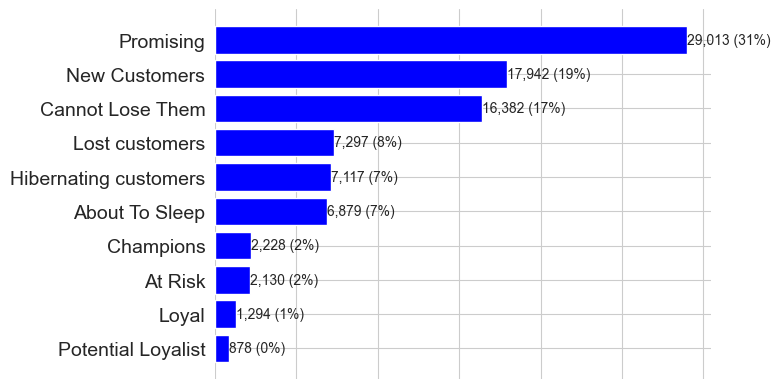

In [16]:
# count the number of customers in each segment
segments_counts = df_RFM['Segments_RFM'].value_counts().sort_values(ascending=True)

fig, ax = plt.subplots()

bars = ax.barh(range(len(segments_counts)),
              segments_counts,
              color='b')
ax.set_frame_on(False)
ax.tick_params(left=False,
               bottom=False,
               labelbottom=False)
ax.set_yticks(range(len(segments_counts)))
ax.set_yticklabels(segments_counts.index,  fontsize = 14)

for i, bar in enumerate(bars):
        value = bar.get_width()
        if segments_counts.index[i] in ['champions', 'loyal customers']:
            bar.set_color('r')
        ax.text(value,
                bar.get_y() + bar.get_height()/2,
                '{:,} ({:}%)'.format(int(value),
                                   int(value*100/segments_counts.sum())),
                va='center',
                ha='left'
               )
sns.set(rc={'figure.figsize':(5,10)})
plt.show()

In [17]:
def rfm_iso_scatter(dat, x, y, z):

    '''
    Function to generate a 3D scatter plot

    Input:
    - dat - dataframe
    - x, y, z - 3 features for the three coordinates

    Output:
    - None (interactive 3D scatter plot)
    '''
    x = dat[x]
    y = dat[dat[y]<5][y]
    z = dat[dat[z]<4000][z]


    fig = go.Figure(data=[go.Scatter3d(
        x=x,
        y=y,
        z=z,
        mode='markers',
        marker=dict(
            size=1,
            color=y,               
            colorscale='thermal',
            opacity=0.8
        )
    )])

    fig.update_layout(scene = dict(
        xaxis_title='Recency',
        yaxis_title='Frequency',
        zaxis_title='Monetary'),
        width=700,
        margin=dict(r=20, b=10, l=10, t=10))

    fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
    fig.show()

In [18]:
# Generate 3d scatter of rfm, trying to spot clustering
# Deactivated for file size reduction (activate for plot)
		

rfm_iso_scatter(df_RFM, 'recency', 'frequency', 'monetary_value')

## Conclusion
En imprimant un graphique en nuage de points 3D pour les trois caractéristiques (Récence, Fréquence, monetary_value), aucun clustering clairement visible ne peut être observé.

C:\Users\User\AppData\Local\Temp\ipykernel_13780\3749360958.py:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



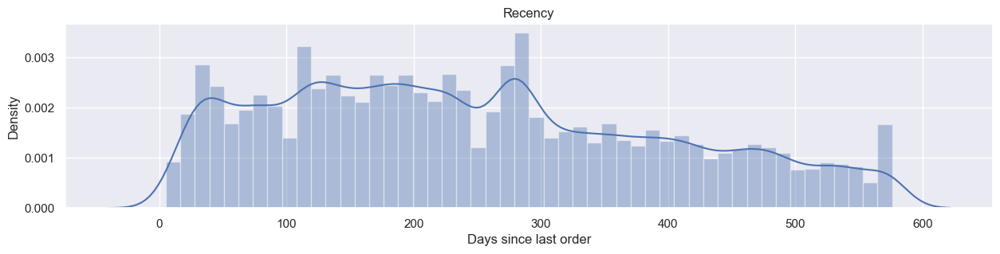

In [19]:
plt.figure(figsize=(15, 3))
sns.distplot(df_RFM['recency'])

plt.xlabel('Days since last order')
plt.title('Recency');

C:\Users\User\AppData\Local\Temp\ipykernel_13780\218384927.py:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




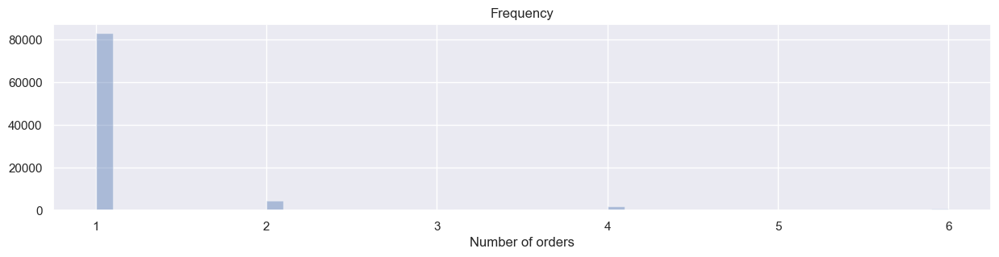

In [20]:
plt.figure(figsize=(15, 3))
sns.distplot(df_RFM['frequency'], kde=False);

plt.xlabel('Number of orders')
plt.title('Frequency');

C:\Users\User\AppData\Local\Temp\ipykernel_13780\1270593775.py:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



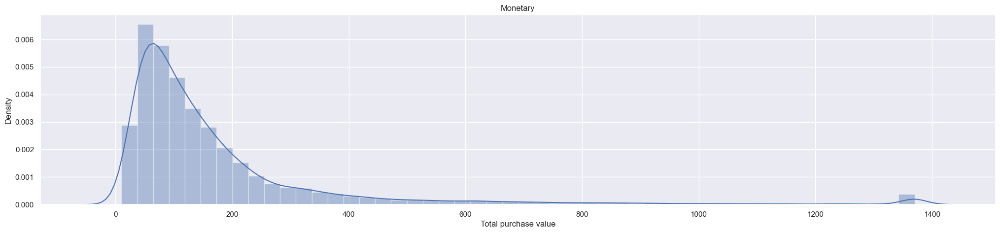

In [21]:
plt.figure(figsize=(25, 5))
sns.distplot(df_RFM['monetary_value']);

plt.xlabel('Total purchase value')
plt.title('Monetary');

In [22]:
df_RFM.columns

Index(['index', 'customer_unique_id', 'frequency', 'recency', 'monetary_value',
       'R', 'F', 'M', 'RFM Score', 'Segment', 'Segments_RFM'],
      dtype='object')

In [23]:

df['Segments_RFM']=df_RFM['Segments_RFM']
# Convertir la colonne 'colonne_a_convertir' de type objet à entier


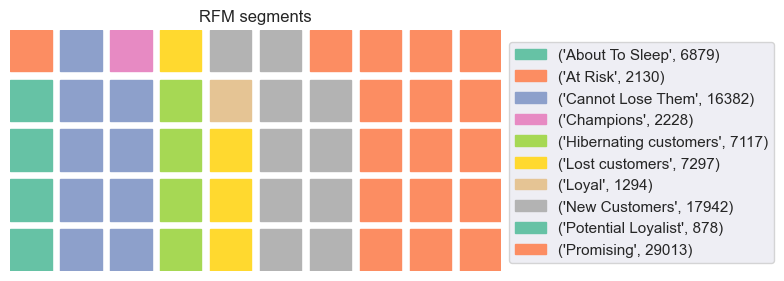

In [24]:
# Vizualize segment sizes with the waffe chart
cv.plot_waffle_chart(df_RFM, 'customer_unique_id', 'count', 'RFM segments','Segments_RFM')

In [25]:
df_RFM['Segments_RFM'].value_counts()

Segments_RFM
Promising                29013
New Customers            17942
Cannot Lose Them         16382
Lost customers            7297
Hibernating customers     7117
About To Sleep            6879
Champions                 2228
At Risk                   2130
Loyal                     1294
Potential Loyalist         878
Name: count, dtype: int64

In [26]:
import folium
import pandas as pd
import matplotlib.pyplot as plt

# Charger votre DataFrame contenant les informations (latitude, longitude, segment)
# df = pd.read_csv('votre_fichier.csv')

# Créer une carte centrée sur le Brésil
brazil_map = folium.Map(location=[-14.235, -51.9253], zoom_start=4)

segment_colors = {
    'Promising': 'red',#inactive
    'New Customers': 'orange',#active
    'Cannot Lose Them': 'yellow',#hot
    'Lost customers': 'green',#cold
    'Hibernating customers': 'blue',
    'About To Sleep': 'purple',
    'Champions': 'pink',
    'At Risk': 'brown',
    'Loyal': 'gray',
    'Potential Loyalist': 'black'
}

# Créer un nuage de points en fonction des coordonnées (latitude, longitude) et colorer en fonction des segments
for index, row in df.iterrows():
    lat, lon, segment = row['geolocation_lat'], row['geolocation_lng'], row['Segments_RFM']
    
    # Vérifier si le segment est présent dans la palette de couleurs
    color = segment_colors.get(segment, 'gray')  # Gris par défaut pour les segments non définis
    
    # Ajouter le point à la carte
    folium.CircleMarker(
        location=[lat, lon],
        radius=1,  # Ajustez la taille des points selon vos préférences
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
    ).add_to(brazil_map)

# Afficher la carte
brazil_map.save('nuage_de_pointsRFM.html')  # Enregistrez la carte en HTML


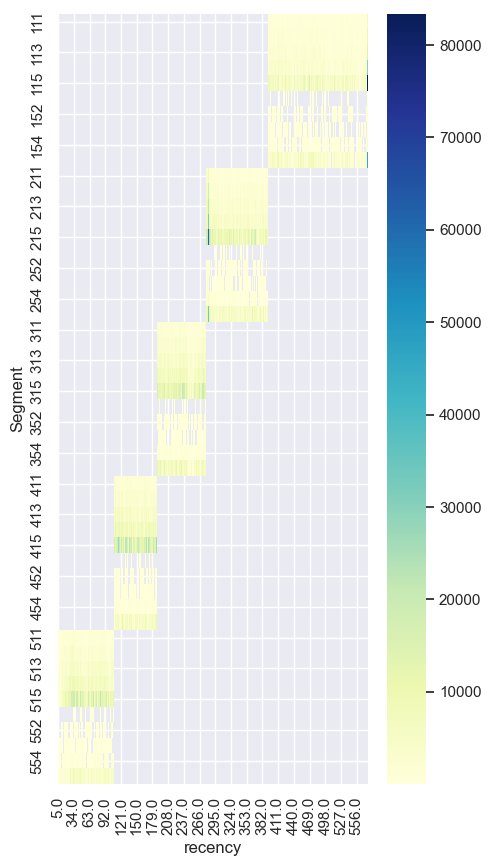

In [27]:
import seaborn as sns

heatmap_data = df_RFM.pivot_table(index='Segment', columns='recency', values='monetary_value', aggfunc='sum')
sns.heatmap(heatmap_data, cmap='YlGnBu')
plt.show()


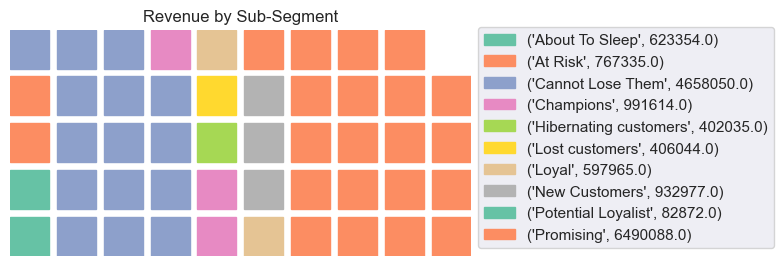

In [28]:
# Total revenue by sub-segment
cv.plot_waffle_chart(df_RFM, 'monetary_value', 'sum', 'Revenue by Sub-Segment','Segments_RFM')

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



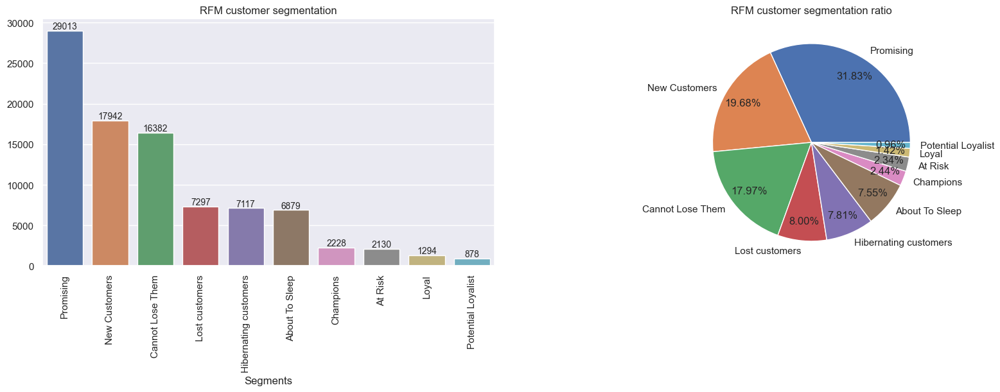

In [29]:
fig=plt.figure(figsize=(20,5))
plt.subplot(1,2,1)
plotSegment=sns.barplot(x=df_RFM['Segments_RFM'].value_counts().index, y=df_RFM['Segments_RFM'].value_counts().values)
for bar in plotSegment.patches:
    plotSegment.annotate(format(bar.get_height(), '.0f'),
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                   size=10, xytext=(0, 5),
                   textcoords='offset points')
plt.xticks(rotation=90)
plotSegment.set_title('RFM customer segmentation')
plotSegment.set_xlabel("Segments")

plt.subplot(1,2,2)
plt.pie(df_RFM['Segments_RFM'].value_counts(),
        labels=df_RFM['Segments_RFM'].value_counts().index,
        autopct='%.2f%%', pctdistance=0.8)
plt.title("RFM customer segmentation ratio")
plt.show()

In [30]:
import plotly.express as px
fig = px.scatter_3d(df_RFM, x='recency', y='frequency', z='monetary_value',
              color='Segments_RFM',width=1000, height=700)
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [31]:
df.to_csv('../data/df_customer_data_mart.csv')

# Unsupervised segmentation of the main dataframe

1.1 Variables selection

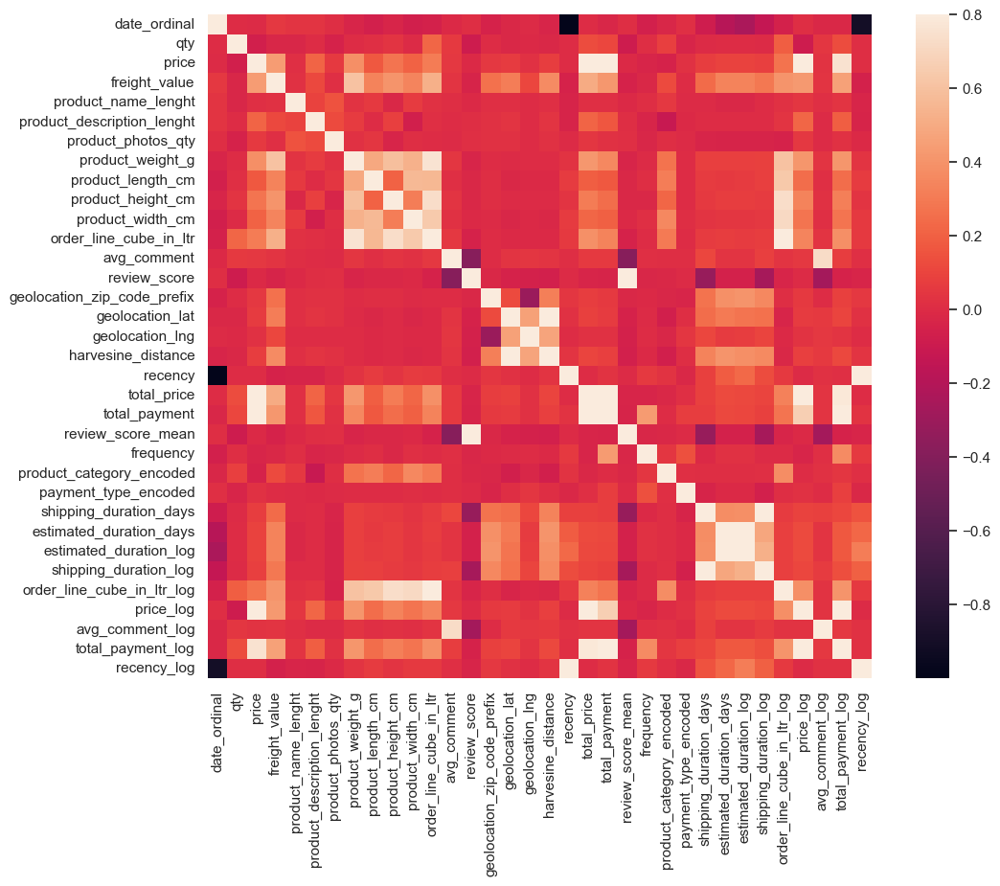

In [32]:
# Sélectionner uniquement les colonnes numériques
numeric_cols = df.select_dtypes(include=[np.number])

# Calculer la matrice de corrélation pour les colonnes numériques
corrmat = numeric_cols.corr()

# Créer le heatmap
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat, vmax=.8, square=True);


representation in 2D using PCA

## Préparation

In [33]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import silhouette_score

In [34]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [35]:
X = df.copy()
categorical_columns = X.select_dtypes(['category','object']).columns
numerical_columns = X.select_dtypes(['int32','int64','float64']).columns

In [36]:
numerical_columns = df.select_dtypes(['int32','int64','float64']).columns

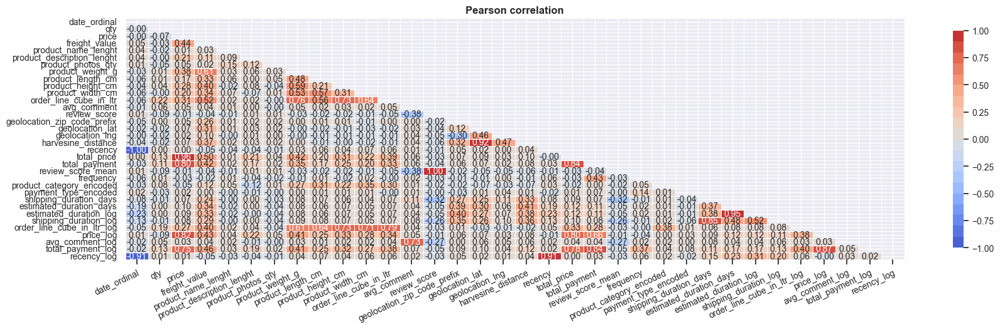

In [37]:

pears_corr = df[numerical_columns].corr()
plot_heatmap(pears_corr, shape='tri',
             title="Pearson correlation", figsize=(20,5))

plt.show()

42 : numerical_columns = ['freight_value', 'frequency', 'recency', 'geolocation_lng','avg_comment','total_payment_log','order_line_cube_in_ltr_log','estimated_duration_log','shipping_duration_log']

In [38]:
df['shipping_duration_days']

0        11
1        12
2        11
3        11
4        11
         ..
91155    10
91156     4
91157     8
91158    11
91159     8
Name: shipping_duration_days, Length: 91160, dtype: int64

In [39]:
#numerical_columns = ['geolocation_zip_code_prefix','freight_value', 'review_score','frequency', 'recency', 'geolocation_lat', 'geolocation_lng','avg_comment','estimated_duration_log','shipping_duration_log', 'order_line_cube_in_ltr_log','total_payment_log']
#numerical_columns = ['geolocation_zip_code_prefix','payment_type_encoded','freight_value', 'review_score_mean','frequency', 'product_category_encoded','recency', 'geolocation_lat', 'geolocation_lng','avg_comment','estimated_duration_log','shipping_duration_log', 'order_line_cube_in_ltr_log','total_payment_log']

#numerical_columns = ['freight_value','harvesine_distance', 'review_score','frequency', 'recency',  'avg_comment_log','estimated_duration_days','shipping_duration_days', 'order_line_cube_in_ltr','total_payment']


numerical_columns = ['freight_value', 'review_score_mean','frequency', 'recency',  'avg_comment_log','estimated_duration_days','shipping_duration_days', 'order_line_cube_in_ltr','total_payment_log']


In [40]:
numerical_columns

['freight_value',
 'review_score_mean',
 'frequency',
 'recency',
 'avg_comment_log',
 'estimated_duration_days',
 'shipping_duration_days',
 'order_line_cube_in_ltr',
 'total_payment_log']

In [41]:
from sklearn.preprocessing import MinMaxScaler
# Créer un nouveau DataFrame avec les colonnes numériques
pca_df = df[numerical_columns].copy()

# Supprimer les lignes avec des valeurs manquantes (NaN)
pca_df.dropna(inplace=True)

scaler = MinMaxScaler()
X = scaler.fit_transform(pca_df[numerical_columns])
#X_sc = pd.merge(X[numerical_columns], df[log_columns])
n_comp = 8
pca = PCA(n_components=n_comp).fit(X)

pca_df = pd.DataFrame(pca.components_,
                      index=['PC'+str(i+1) for i in range(n_comp)],
                      columns=numerical_columns).T

X_proj = pca.transform(X)


c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `

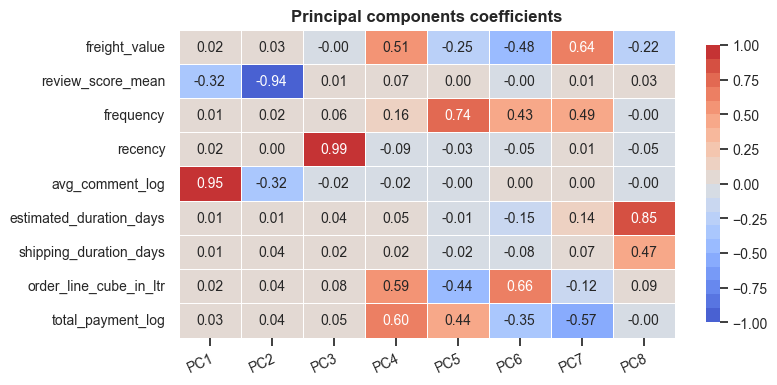

In [42]:

plot_heatmap(pca_df,'Principal components coefficients', vmin=-1, vmax=1, center=0,
             palette=sns.color_palette("coolwarm", 20),figsize=(8,4),shape='rect')
plt.show()

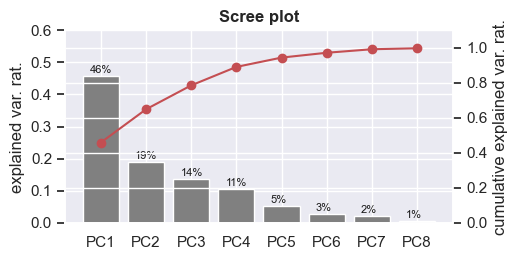

In [43]:
exp_var_rat = pca.explained_variance_ratio_
scree_plot(col_names= pca_df.columns, exp_var_rat=exp_var_rat,
           ylim=(0,0.6), figsize=(5,2.5))
plt.show()

In [44]:
x_show = pca.transform(X)[:,0]

y_show = pca.transform(X)[:,1]

z_show = pca.transform(X)[:,2]

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



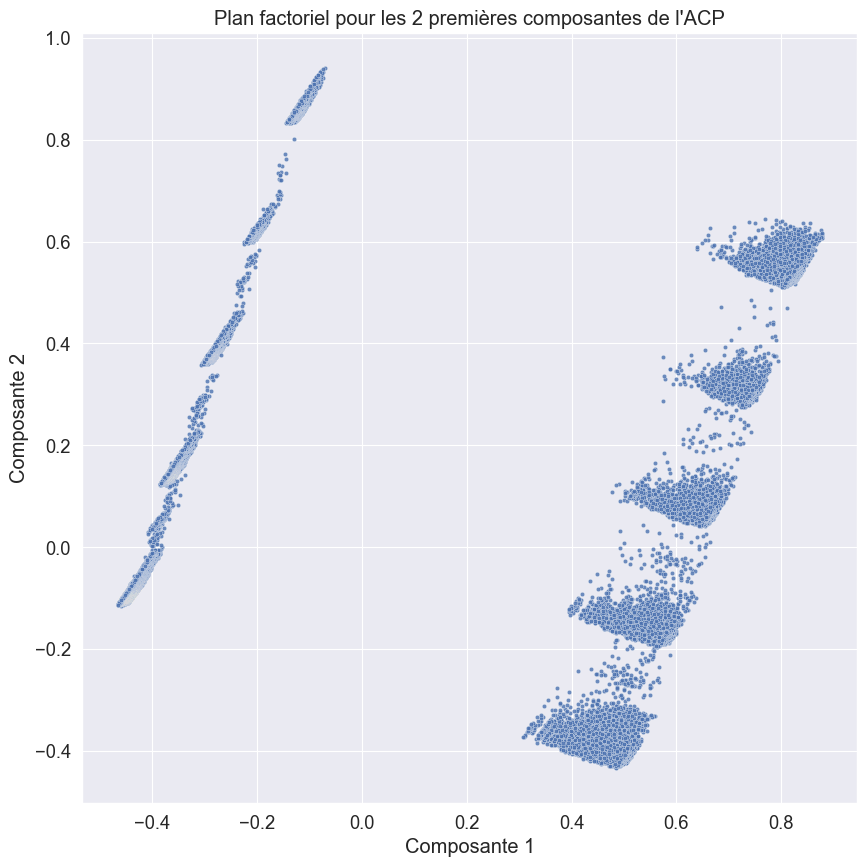

In [45]:
sns.set_context("paper", font_scale=1.5) 
plt.figure(figsize=(10,10))
chaine = "Plan factoriel pour les 2 premières composantes de l'ACP"
plt.title(chaine)
plt.xlabel('Composante 1')
plt.ylabel('Composante 2')
ax = plt.gca()

sns.scatterplot(x = x_show,
                y = y_show,
                #hue = hue_show,
                alpha=0.8, s=10)

sns.set_context("paper", font_scale=1) 

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



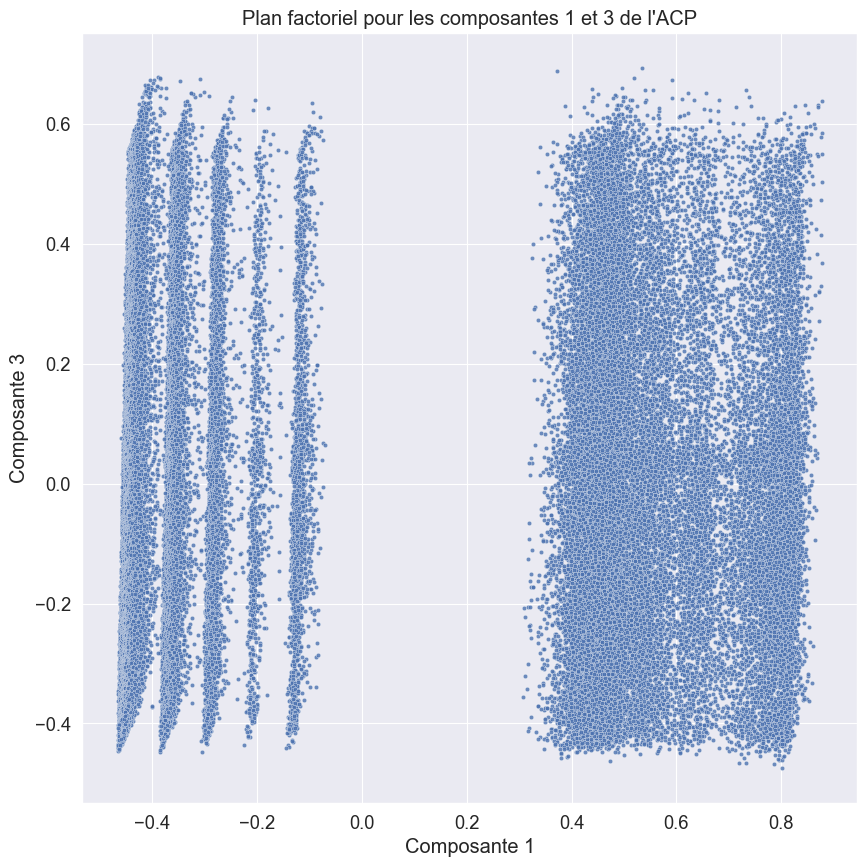

In [46]:
sns.set_context("paper", font_scale=1.5) 
plt.figure(figsize=(10,10))
chaine = "Plan factoriel pour les composantes 1 et 3 de l'ACP"
plt.title(chaine)
plt.xlabel('Composante 1')
plt.ylabel('Composante 3')
ax = plt.gca()

sns.scatterplot(x = x_show,
                y = z_show,
                #hue = hue_show,
                alpha=0.8, s=10)
sns.set_context("paper", font_scale=1) 

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



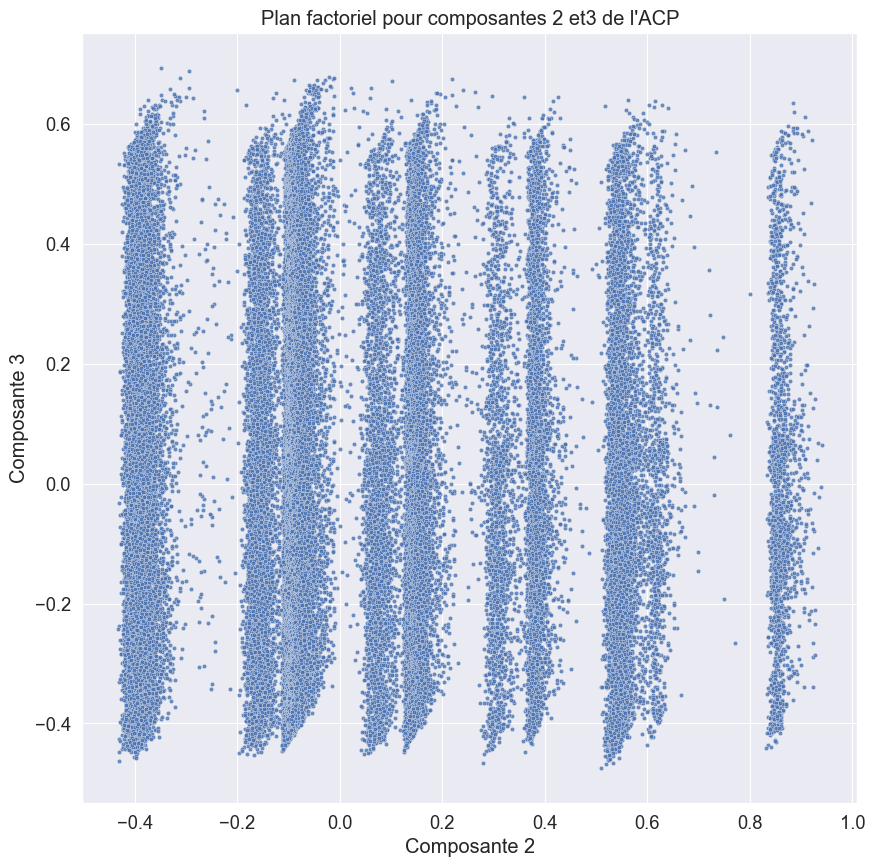

In [47]:
from matplotlib.patches import Circle
sns.set_context("paper", font_scale=1.5) 
plt.figure(figsize=(10,10))
chaine = "Plan factoriel pour composantes 2 et3 de l'ACP"
plt.title(chaine)
plt.xlabel('Composante 2')
plt.ylabel('Composante 3')
ax = plt.gca()

sns.scatterplot(x = y_show,
                y = z_show,
                #hue = hue_show,
                alpha=0.8, s=10)

sns.set_context("paper", font_scale=1) 

In [48]:
pca.explained_variance_ratio_.cumsum()

array([0.45885825, 0.64869533, 0.78533026, 0.89078906, 0.9440568 ,
       0.97168199, 0.9917457 , 0.99724326])

In [49]:
x_y = (0,1)

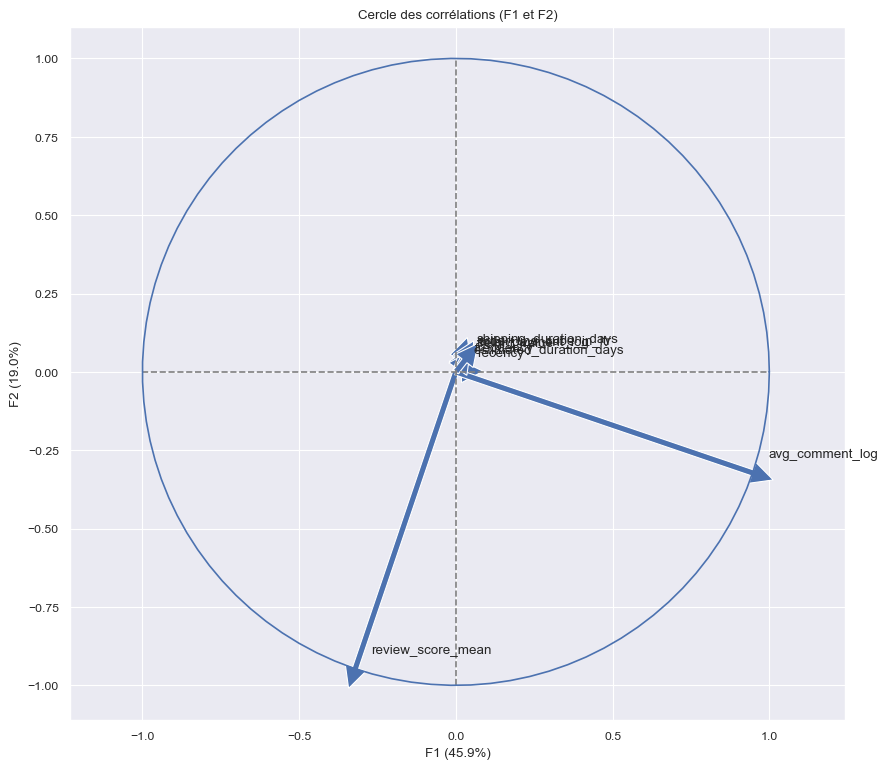

In [50]:
correlation_graph(pca, x_y, numerical_columns)

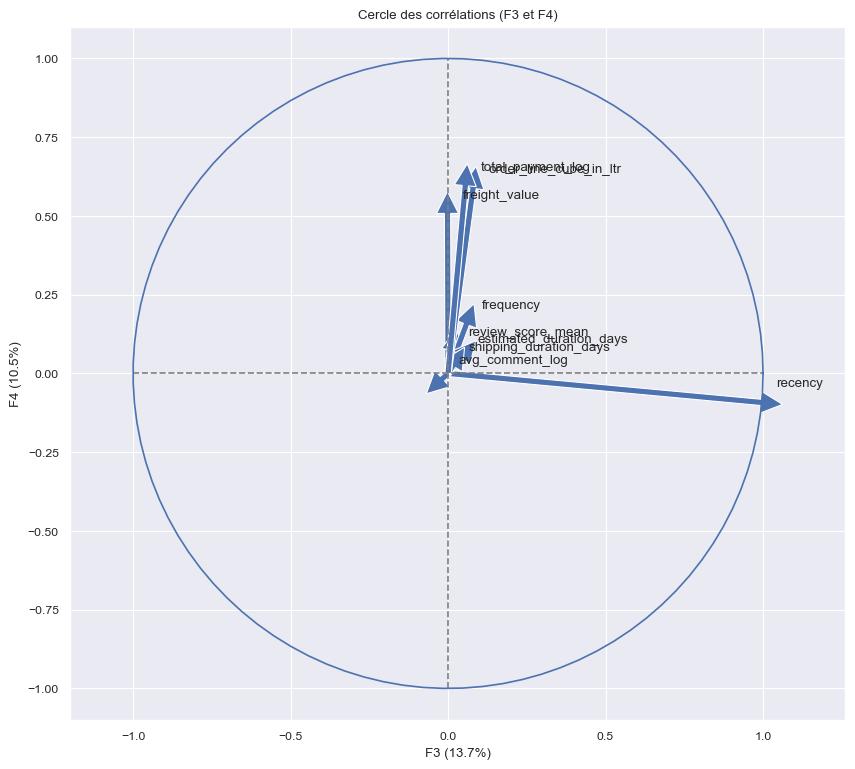

In [51]:
correlation_graph(pca, (2,3), numerical_columns)

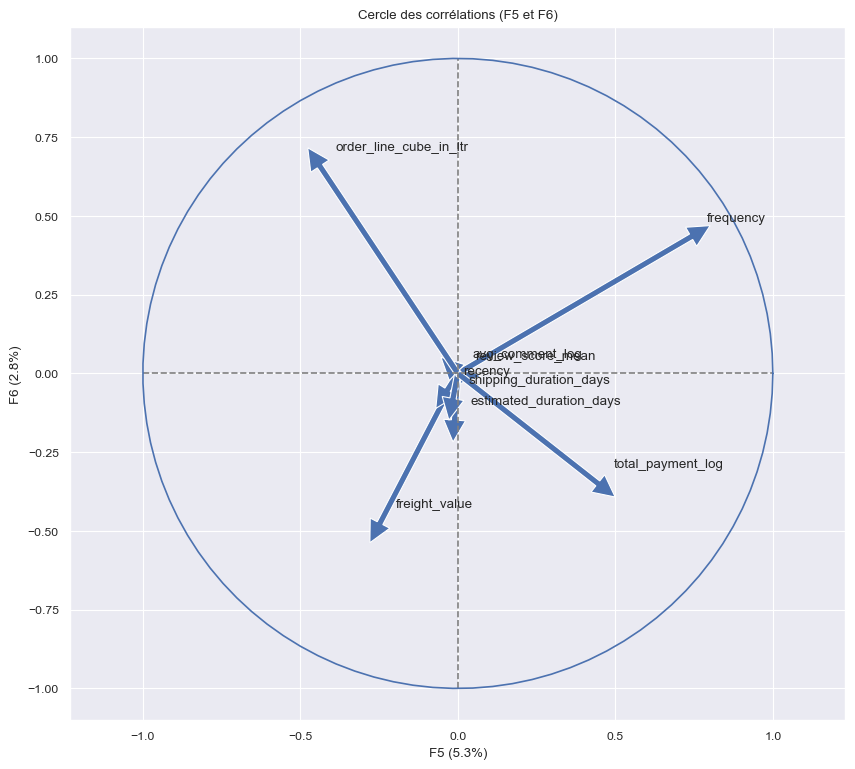

In [52]:
correlation_graph(pca, (4,5), numerical_columns)

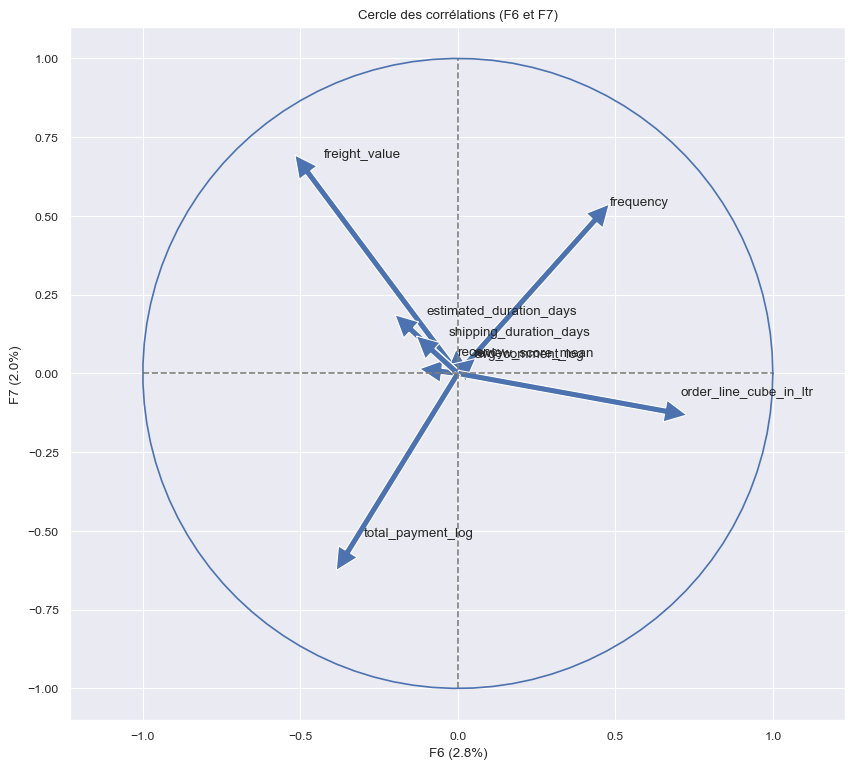

In [53]:
correlation_graph(pca, (5,6), numerical_columns)

In [54]:
pca_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
freight_value,0.018421,0.031011,-0.001691,0.507849,-0.247005,-0.475379,0.637040,-0.219009
review_score_mean,-0.319726,-0.943535,0.013919,0.072911,0.003660,-0.000488,0.007063,0.026224
frequency,0.009198,0.016275,0.058031,0.155756,0.740585,0.433860,0.485036,-0.002277
recency,0.017333,0.000436,0.992360,-0.091907,-0.032676,-0.051842,0.006361,-0.051327
avg_comment_log,0.946340,-0.322197,-0.017954,-0.016790,-0.002982,0.002851,0.002382,-0.000702
estimated_duration_days,0.006213,0.008946,0.042767,0.050359,-0.010422,-0.148023,0.138110,0.849173
shipping_duration_days,0.014522,0.043579,0.015202,0.024089,-0.015269,-0.079624,0.071842,0.469110
order_line_cube_in_ltr,0.022026,0.038433,0.079272,0.587639,-0.437744,0.657983,-0.119603,0.086887
total_payment_log,0.027512,0.035322,0.054697,0.596112,0.444377,-0.349130,-0.565935,-0.000311


In [55]:
X_proj


array([[ 0.50747235, -0.38142169,  0.63039657, ...,  0.24622067,
         0.20595617,  0.00233921],
       [-0.42504594, -0.07606321,  0.63288226, ...,  0.33966333,
         0.36058018,  0.00536678],
       [ 0.47007985, -0.3961161 ,  0.58352791, ...,  0.22622731,
         0.26089658,  0.00340267],
       ...,
       [-0.21937737,  0.60494849, -0.40426391, ...,  0.1902149 ,
         0.03275088, -0.08853441],
       [-0.45254563, -0.09353409, -0.38684771, ..., -0.01645896,
         0.0535986 , -0.02458773],
       [-0.27880929,  0.39568997, -0.36833531, ..., -0.21601963,
        -0.22340446, -0.06896877]])

## T-SNE
utilisons l'algorithme T-SNE pour avoir une idée en première approche du nombre de groupes homogènes

In [56]:
X_sc=X.copy()
tsne = TSNE(n_components=2)
T = tsne.fit_transform(X_sc.copy())


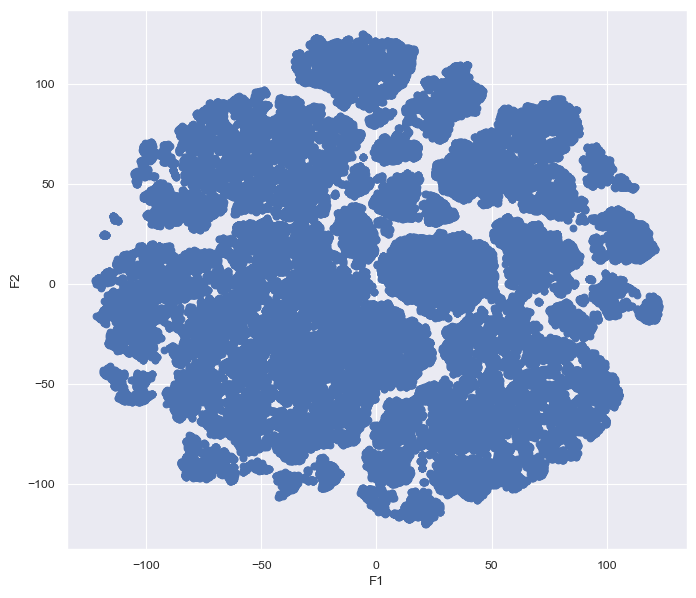

In [57]:
fig, ax = plt.subplots(1,1, figsize=(8,7))
ax.scatter(T[:, 0], T[:, 1])
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()

In [58]:
#data_cluster_scaled=df[numerical_columns].copy().dropna()
#data_reduce = data_cluster_scaled.sample(50000, random_state=1).copy()

data_cluster=df[numerical_columns].copy().dropna()
scaler = MinMaxScaler()
data_cluster_scaled = scaler.fit_transform(X_proj[:,:4])
data_reduce = data_cluster_scaled

In [59]:
nb_clusters_agg=10

# Kmeans

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_i

Text(0.5, 1.0, 'Davies bouldin score For Optimal number of clusters')

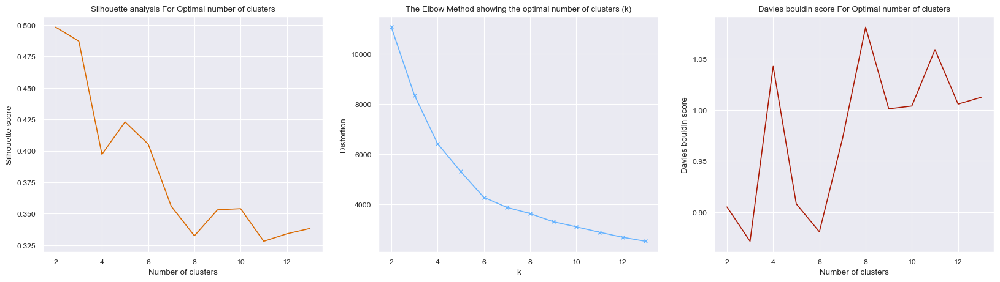

In [60]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score


dist_value = []
sil_score = []
davies_score = []
range_n_clusters = range(2,14)
for k in range_n_clusters:
    kmeanModel1 = KMeans(n_clusters=k,init='k-means++')
    kmeanModel1.fit(data_cluster_scaled)
    dist_value.append(kmeanModel1.inertia_)
    sil_score.append(silhouette_score(data_cluster_scaled, kmeanModel1.labels_))
    davies_score.append(davies_bouldin_score(data_cluster_scaled, kmeanModel1.labels_))

plt.subplots(figsize=(20, 5))
plt.subplot(1,3,1)
plt.plot(range_n_clusters,sil_score, color="#DA6A00")
plt.xlabel('Number of clusters') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal number of clusters')

plt.subplot(1,3,2)
plt.plot(range_n_clusters, dist_value, 'bx-', color = "#66b3ff")
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal number of clusters (k)')

plt.subplot(1,3,3)
plt.plot(range_n_clusters,davies_score, color="#AA1803")
plt.xlabel('Number of clusters') 
plt.ylabel('Davies bouldin score') 
plt.title('Davies bouldin score For Optimal number of clusters')
#--------------------------------------------


In [61]:

data_score_clustering = pd.DataFrame(columns=['Model', 'Number_of_cluster', 'silhouette_score', 'calinski_harabasz_score', 'davies_bouldin_score'])


In [62]:
nb_clusters_agg=10

from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
kmeansSelected= KMeans(n_clusters=nb_clusters_agg,init='k-means++')
kmeansSelected.fit(data_cluster_scaled)

clustered_kmeans = df[numerical_columns].copy().dropna()
clustered_kmeans['labels_kmeans']= kmeansSelected.labels_

data_score_clustering.loc[0] = ["Kmeans",nb_clusters_agg, silhouette_score(data_cluster_scaled, kmeansSelected.labels_), calinski_harabasz_score(data_cluster_scaled, kmeansSelected.labels_), davies_bouldin_score(data_cluster_scaled, kmeansSelected.labels_)]


print("kmeans Silhouette score with ',nb_clusters_agg,' cluster", data_score_clustering.loc[0]['silhouette_score'])
print("kmeans Calinski harabasz score with ',nb_clusters_agg,' cluster", data_score_clustering.loc[0]['calinski_harabasz_score'])
print("kmeans Davies bouldin score with ',nb_clusters_agg,' cluster", data_score_clustering.loc[0]['davies_bouldin_score'])

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



kmeans Silhouette score with ',nb_clusters_agg,' cluster 0.3404748353104321
kmeans Calinski harabasz score with ',nb_clusters_agg,' cluster 63142.68511100749
kmeans Davies bouldin score with ',nb_clusters_agg,' cluster 1.0601256748965113


### Representation

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



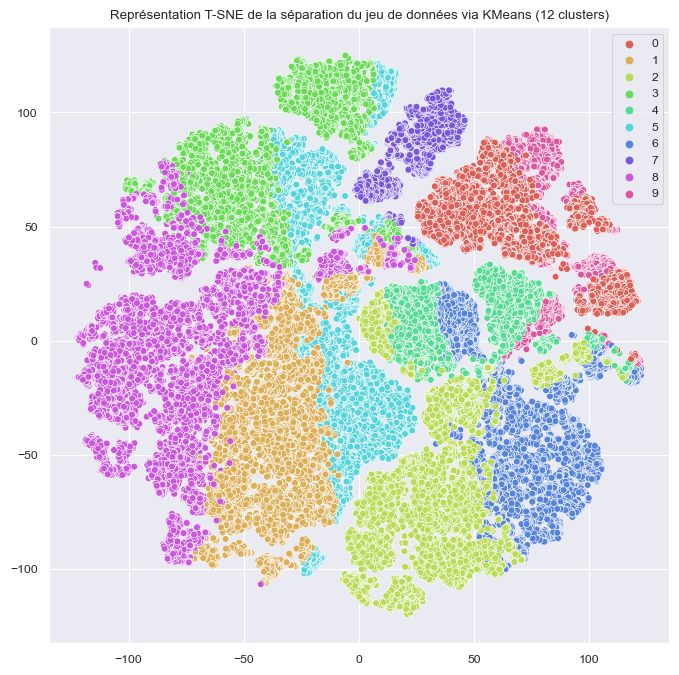

In [63]:
   
plt.figure(figsize=(8, 8))
plt.title('Représentation T-SNE de la séparation du jeu de données via KMeans (12 clusters)')
sns.scatterplot(x=T[:, 0], y=T[:, 1], hue=kmeansSelected.labels_ , palette=sns.color_palette("hls",nb_clusters_agg))
plt.show()


C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



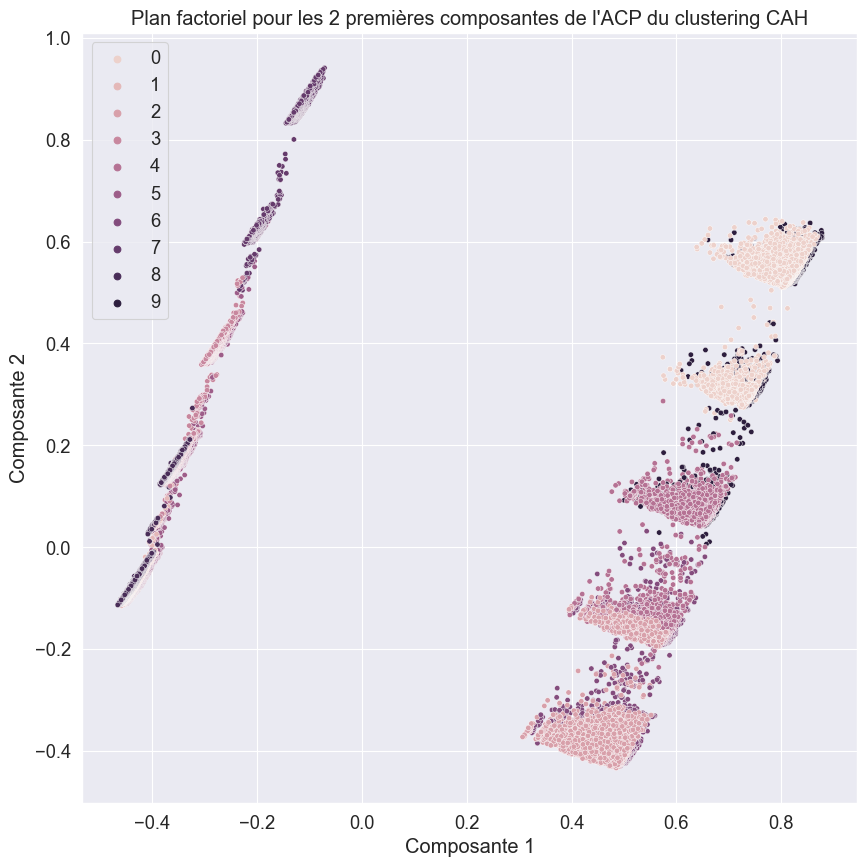

In [64]:
from matplotlib.patches import Circle
sns.set_context("paper", font_scale=1.5) 
plt.figure(figsize=(10,10))
chaine = "Plan factoriel pour les 2 premières composantes de l'ACP\
 du clustering CAH"
plt.title(chaine)
plt.xlabel('Composante 1')
plt.ylabel('Composante 2')
ax = plt.gca()

sns.scatterplot(x = x_show, 
                y = y_show, 
                hue = kmeansSelected.labels_,
                alpha=1, s=15, legend='full')

sns.set_context("paper", font_scale=1) 

# Gaussian Mixture clustering

Le clustering par mélange gaussien (Gaussian Mixture Model - GMM) est un algorithme d'apprentissage non supervisé qui appartient à la famille des modèles de mélange probabiliste. Contrairement à certains autres algorithmes de clustering, le GMM n'assigne pas directement chaque point de données à un cluster spécifique, mais estime plutôt la probabilité que chaque point appartienne à chaque cluster. Cela signifie qu'un point de données peut appartenir à plusieurs clusters, chacun avec une certaine probabilité.

Voici comment fonctionne le clustering par mélange gaussien :

1. Modélisation de la Distribution des Données :
Le GMM suppose que les données proviennent d'un certain nombre de distributions gaussiennes (normales) différentes.
Chaque distribution gaussienne représente l'un des clusters potentiels.
2. Estimation des Paramètres :
L'objectif du GMM est d'estimer les paramètres de ces distributions gaussiennes, y compris les moyennes, les matrices de covariance et les pondérations (probabilités a priori des clusters).
Ces paramètres sont ajustés itérativement pour maximiser la vraisemblance des données observées.
3. Estimation des Probabilités d'Appartenance :
Une fois que les paramètres sont estimés, le modèle peut être utilisé pour calculer la probabilité qu'un point de données appartienne à chaque cluster.
Les points de données sont souvent attribués au cluster avec la probabilité la plus élevée.
Avantages du GMM :
Flexibilité : Le GMM est capable de modéliser des formes de clusters complexes en ajustant plusieurs distributions gaussiennes.
Estimation des Incertitudes : Il fournit des estimations probabilistes de l'appartenance au cluster, ce qui peut être utile dans certaines applications.
Gère les Clusters de Taille et de Forme Variables : Chaque composante gaussienne peut avoir sa propre forme, taille et orientation, ce qui rend le GMM plus flexible que certains autres algorithmes de clustering.
Limitations du GMM :
Sensibilité aux Initialisations : Les performances du GMM peuvent dépendre fortement des initialisations des paramètres.
Complexité Computationnelle : L'estimation des paramètres implique des calculs complexes, en particulier pour les matrices de covariance.
Le GMM est souvent utilisé lorsque les données sont supposées provenir de plusieurs distributions gaussiennes cachées. Il peut être appliqué dans des domaines tels que l'analyse des images, la segmentation d'images, l'analyse du comportement des consommateurs, et d'autres domaines où les données peuvent être générées à partir de mélanges de différentes sources. Pour obtenir de bons résultats, il est souvent recommandé de faire des initialisations multiples pour les paramètres du modèle.

C:\Users\User\AppData\Local\Temp\ipykernel_13780\1683918872.py:19: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



Text(0.5, 1.0, 'Calinski harabasz score for Optimal number of clusters')

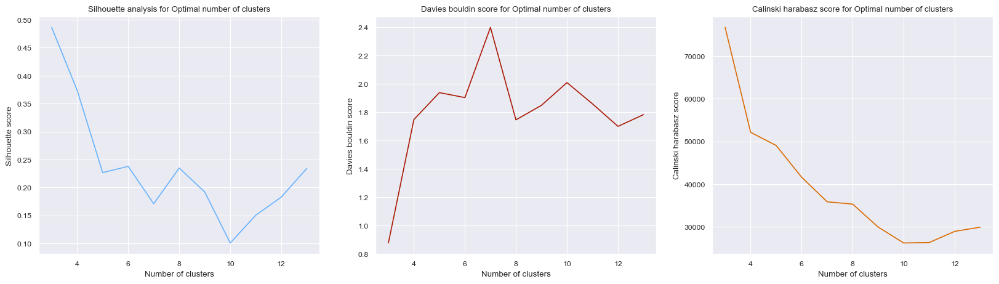

In [65]:
from sklearn.mixture import GaussianMixture


sil_score_gmm = []
cal_score_gmm =[]
davies_score_gmm = []
n_components = range(3,14)
for k in n_components:
    gmm = GaussianMixture(n_components=k)
    gmm.fit(data_cluster_scaled)
    pred = gmm.predict(data_cluster_scaled)
    sil_score_gmm.append(silhouette_score(data_cluster_scaled, pred))
    davies_score_gmm.append(davies_bouldin_score(data_cluster_scaled, pred))
    cal_score_gmm.append(calinski_harabasz_score(data_cluster_scaled, pred))
    
plt.subplots(figsize=(20, 5))


plt.subplot(1,3,1)
plt.plot(n_components,sil_score_gmm, color = "#66b3ff")
plt.xlabel('Number of clusters') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis for Optimal number of clusters')


plt.subplot(1,3,2)
plt.plot(n_components,davies_score_gmm, color="#AA1803")
plt.xlabel('Number of clusters') 
plt.ylabel('Davies bouldin score') 
plt.title('Davies bouldin score for Optimal number of clusters')

plt.subplot(1,3,3)
plt.plot(n_components,cal_score_gmm, color="#DA6A00")
plt.xlabel('Number of clusters') 
plt.ylabel('Calinski harabasz score') 
plt.title('Calinski harabasz score for Optimal number of clusters')



Silhouette score is in the range of -1 to 1. A score near 1 denotes the best meaning that the data point i is very compact within the cluster to which it belongs and far away from the other clusters. The worst value is -1. Values near 0 denote overlapping clusters. The Silhouette Coefficient is calculated using the mean intra-cluster distance (a) and the mean nearest-cluster distance (b) for each sample. The Silhouette Coefficient for a sample is (b - a) / max(a, b). To clarify, b is the distance between a sample and the nearest cluster that the sample is not a part of. Note that Silhouette Coefficient is only defined if number of labels is 2 <= n_labels <= n_samples - 1.

calinski_harabasz_score It is also known as the Variance Ratio Criterion. The score is defined as ratio of the sum of between-cluster dispersion and of within-cluster dispersion. A higher Calinski-Harabasz score relates to a model with better defined clusters.

davies_bouldin_score The score is defined as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances. Thus, clusters which are farther apart and less dispersed will result in a better score. The minimum score is zero, with lower values indicating better clustering.

In [66]:
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(n_components=nb_clusters_agg)
gmm.fit(data_cluster_scaled)
pred = gmm.predict(data_cluster_scaled)


data_score_clustering.loc[1] = ["Gaussian mixture", nb_clusters_agg, silhouette_score(data_cluster_scaled,pred), calinski_harabasz_score(data_cluster_scaled,pred), davies_bouldin_score(data_cluster_scaled, pred)]


print("Silhouette score for ',nb_clusters_agg,' cluster from model Gaussian mixture", data_score_clustering.loc[1]['silhouette_score'])
print("Calinski harabasz score for ',nb_clusters_agg,' cluster from model Gaussian mixture", data_score_clustering.loc[1]['calinski_harabasz_score'])
print("Davies bouldin score for ',nb_clusters_agg,' cluster from model Gaussian mixture", data_score_clustering.loc[1]['davies_bouldin_score'])

Silhouette score for ',nb_clusters_agg,' cluster from model Gaussian mixture 0.16790702442066915
Calinski harabasz score for ',nb_clusters_agg,' cluster from model Gaussian mixture 28159.258595147017
Davies bouldin score for ',nb_clusters_agg,' cluster from model Gaussian mixture 1.8661917228464642


C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



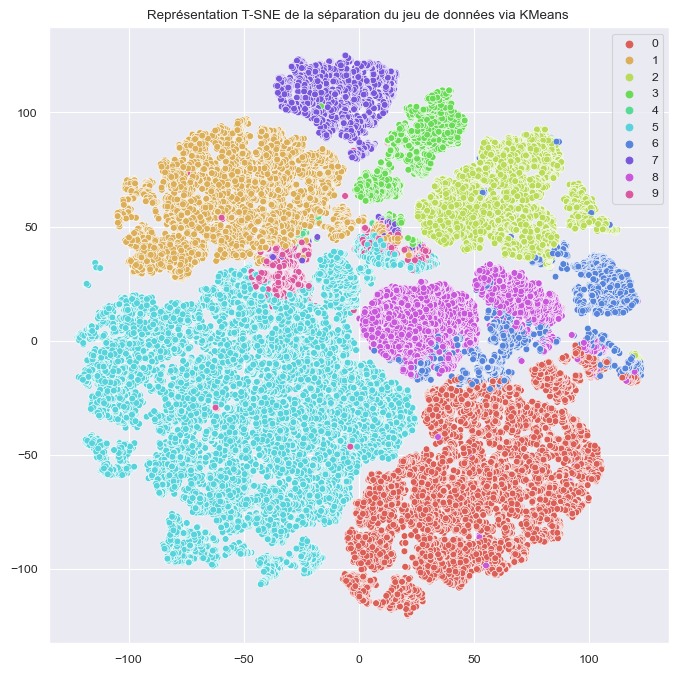

In [68]:
plt.figure(figsize=(8, 8))
plt.title('Représentation T-SNE de la séparation du jeu de données via KMeans ')
sns.scatterplot(x=T[:, 0], y=T[:, 1], hue= pred , palette=sns.color_palette("hls",nb_clusters_agg))
plt.show()

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



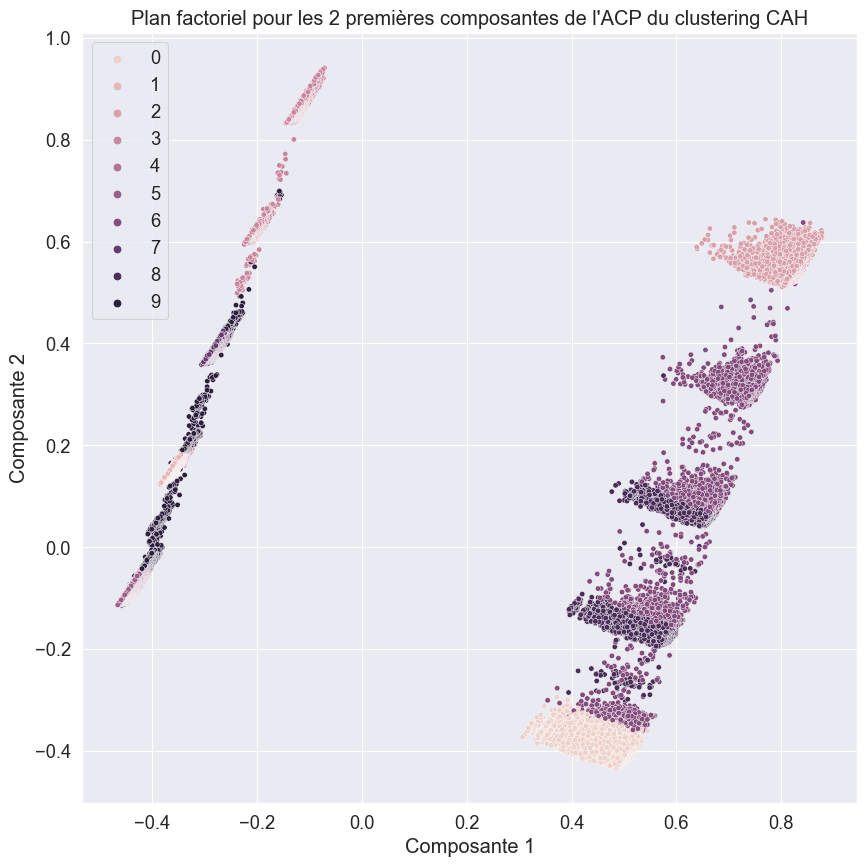

In [69]:
from matplotlib.patches import Circle
sns.set_context("paper", font_scale=1.5) 
plt.figure(figsize=(10,10))
chaine = "Plan factoriel pour les 2 premières composantes de l'ACP\
 du clustering CAH"
plt.title(chaine)
plt.xlabel('Composante 1')
plt.ylabel('Composante 2')
ax = plt.gca()

sns.scatterplot(x = x_show, 
                y = y_show, 
                hue =  pred,
                alpha=1, s=15, legend='full')

sns.set_context("paper", font_scale=1) 

# Birch

BIRCH (Balanced Iterative Reducing and Clustering using Hierarchies) est un algorithme de clustering hiérarchique qui a été spécialement conçu pour traiter de grands ensembles de données. Il est particulièrement adapté pour les données qui ne tiennent pas en mémoire vive (RAM) et pour lesquelles un traitement efficace est nécessaire. Voici comment fonctionne BIRCH :

Création de l'Arborescence : BIRCH construit une structure d'arborescence (comme un arbre B) appelée Clustering Feature Tree (CF Tree). Cette structure est utilisée pour organiser les données en mémoire de manière à minimiser l'accès aux données sur le disque, réduisant ainsi les temps d'accès et les coûts.

Compresser les Données : BIRCH utilise des méthodes de compression de données pour réduire l'espace nécessaire pour stocker les points de données. Il utilise des méthodes comme l'encodage des points et l'encodage des clusters pour économiser de l'espace.

Clustering : L'algorithme effectue un clustering agglomératif sur les données. Il commence par les points individuels et les agrège progressivement en clusters plus grands, en utilisant l'arbre de caractéristiques pour optimiser ce processus.

Sélection des Centres de Cluster : Au fur et à mesure de l'agglomération des données, BIRCH utilise des métriques de compacité et de densité pour décider des centres de cluster. Cette méthode permet de garantir que les clusters sont compacts et bien répartis dans l'espace.

Avantages de BIRCH :

Il est adapté pour les grands ensembles de données qui ne tiennent pas en mémoire vive.
Il est capable de traiter efficacement des données avec un grand nombre de dimensions.
Il ne nécessite pas de spécifier le nombre de clusters à l'avance.
Inconvénients de BIRCH :

Il peut être sensible aux valeurs atypiques (outliers) dans les données.
La qualité des clusters peut être affectée par les paramètres de l'algorithme, tels que le facteur de seuil et la taille maximale des clusters.
BIRCH est particulièrement utile dans les applications où l'efficacité du traitement des données est cruciale, comme l'exploration de grands ensembles de données ou l'analyse en continu de flux de données.




c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_birch.py:726: ConvergenceWarning:

Number of subclusters found (3) by BIRCH is less than (4). Decrease the threshold.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_birch.py:726: ConvergenceWarning:

Number of subclusters found (3) by BIRCH is less than (5). Decrease the threshold.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_birch.py:726: ConvergenceWarning:

Number of subclusters found (3) by BIRCH is less than (6). Decrease the threshold.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_birch.py:726: ConvergenceWarning:

Number of subclusters found (3) by BIRCH is less than (7). Decrease the threshold.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_birch.py:726: ConvergenceWarning:

Number of subclusters found (3) by BIRCH is less than (8). Decrease the threshold.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\cluster\_birch.py:726: ConvergenceWarning:

Number of 

Text(0.5, 1.0, 'Calinski harabasz score for Optimal number of clusters')

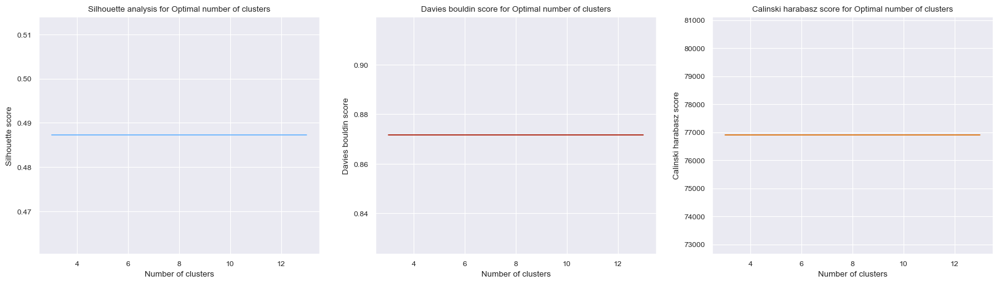

In [70]:
from sklearn.cluster import Birch

sil_score_birch = []
cal_score_birch =[]
davies_score_birch = []
n_components = range(3,14)
for k in n_components:
    birch = Birch(branching_factor = 200, n_clusters = k, threshold = 0.4)
    brcModel=birch.fit(data_cluster_scaled)
    sil_score_birch.append(silhouette_score(data_cluster_scaled, brcModel.labels_))
    davies_score_birch.append(davies_bouldin_score(data_cluster_scaled, brcModel.labels_))
    cal_score_birch.append(calinski_harabasz_score(data_cluster_scaled, brcModel.labels_))
    
plt.subplots(figsize=(20, 5))


plt.subplot(1,3,1)
plt.plot(n_components,sil_score_birch, color = "#66b3ff")
plt.xlabel('Number of clusters') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis for Optimal number of clusters')


plt.subplot(1,3,2)
plt.plot(n_components,davies_score_birch, color="#AA1803")
plt.xlabel('Number of clusters') 
plt.ylabel('Davies bouldin score') 
plt.title('Davies bouldin score for Optimal number of clusters')

plt.subplot(1,3,3)
plt.plot(n_components,cal_score_birch, color="#DA6A00")
plt.xlabel('Number of clusters') 
plt.ylabel('Calinski harabasz score') 
plt.title('Calinski harabasz score for Optimal number of clusters')

Silhouette score is in the range of -1 to 1. A score near 1 denotes the best meaning that the data point i is very compact within the cluster to which it belongs and far away from the other clusters. The worst value is -1. Values near 0 denote overlapping clusters. The Silhouette Coefficient is calculated using the mean intra-cluster distance (a) and the mean nearest-cluster distance (b) for each sample. The Silhouette Coefficient for a sample is (b - a) / max(a, b). To clarify, b is the distance between a sample and the nearest cluster that the sample is not a part of. Note that Silhouette Coefficient is only defined if number of labels is 2 <= n_labels <= n_samples - 1.

calinski_harabasz_score It is also known as the Variance Ratio Criterion. The score is defined as ratio of the sum of between-cluster dispersion and of within-cluster dispersion. A higher Calinski-Harabasz score relates to a model with better defined clusters.

davies_bouldin_score The score is defined as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances. Thus, clusters which are farther apart and less dispersed will result in a better score. The minimum score is zero, with lower values indicating better clustering.

In [98]:
from sklearn.cluster import Birch
from sklearn.metrics import calinski_harabasz_score
nb_clusters_agg=10
cluster_brc = Birch(branching_factor = 2000, n_clusters = nb_clusters_agg, threshold = 0.4)


scaler = MinMaxScaler()
X_scaled_bis = scaler.fit_transform(X_proj)
data_cluster_scaled = scaler.fit_transform(data_cluster)
X_scaled_bis_1 = pd.DataFrame(data_cluster_scaled, index=data_cluster.index, columns=data_cluster.columns)
cluster_labels = cluster_brc.fit_predict(X_scaled_bis)  # Get cluster labels using fit_predict instead of fit
X_scaled_bis_2=X_scaled_bis_1.copy()
# Add cluster labels to the data_cluster_scaled DataFrame
X_scaled_bis_1['index_cluster'] = cluster_labels
X_scaled_bis_2['Segments_RFM'] = df['Segments_RFM']
# Rest of your code
brc_clusters_means = X_scaled_bis_1.groupby('index_cluster').mean()
rfm_df=X_scaled_bis_2.groupby('Segments_RFM').mean()
brc_clusters_means












c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `

,freight_value,review_score_mean,frequency,recency,avg_comment_log,estimated_duration_days,shipping_duration_days,order_line_cube_in_ltr,total_payment_log
index_cluster,,,,,,,,,
0,0.225774,0.865365,0.670100,0.285016,0.944027,0.141131,0.055927,0.117615,0.764247
1,0.233118,0.897434,0.009069,0.259721,0.942965,0.137706,0.054627,0.107746,0.481858
2,0.255289,0.200916,0.686183,0.529520,0.962996,0.156618,0.078657,0.137071,0.793411
3,0.225297,0.928382,0.009213,0.254045,0.000000,0.134004,0.052370,0.103004,0.474567
4,0.215795,0.849665,0.723520,0.514601,0.000000,0.142502,0.056125,0.118576,0.793055
5,0.241693,0.281255,0.020823,0.410856,0.000000,0.145334,0.087630,0.126599,0.487263
6,0.251480,0.075051,0.021559,0.419601,0.966338,0.146462,0.090872,0.151842,0.520361
7,0.225284,0.913110,0.010877,0.730020,0.000000,0.143680,0.054295,0.136439,0.486521
8,0.235038,0.901704,0.011711,0.735948,0.941919,0.146567,0.056007,0.143032,0.498696


In [99]:
print("Silhouette score for  cluster from model Birch",silhouette_score(X_scaled_bis_1, cluster_labels))

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.



Silhouette score for  cluster from model Birch 0.6658683186559461


In [100]:

data_score_clustering.loc[2] = ["Birch", nb_clusters_agg, silhouette_score(X_scaled_bis_1, cluster_labels), calinski_harabasz_score(X_scaled_bis_1, cluster_labels), davies_bouldin_score(X_scaled_bis_1,cluster_labels)]

print("Silhouette score for 10 cluster from model Birch", data_score_clustering.loc[2]['silhouette_score'])
print("Calinski harabasz score for 10 cluster from model Birch", data_score_clustering.loc[2]['calinski_harabasz_score'])
print("Davies bouldin score for 10 cluster from model Birch", data_score_clustering.loc[2]['davies_bouldin_score'])

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.



Silhouette score for 10 cluster from model Birch 0.6658683186559461
Calinski harabasz score for 10 cluster from model Birch 449156.76563078596
Davies bouldin score for 10 cluster from model Birch 0.5680001320491552


c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



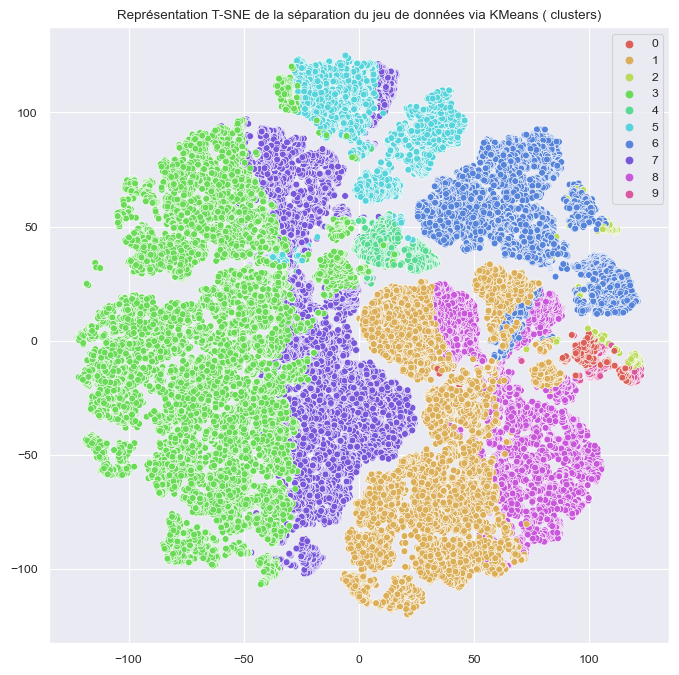

In [111]:
plt.figure(figsize=(8, 8))
plt.title('Représentation T-SNE de la séparation du jeu de données via KMeans ( clusters)')
sns.scatterplot(x=T[:, 0], y=T[:, 1], hue=cluster_labels, palette=sns.color_palette("hls",nb_clusters_agg))
plt.show()

## DBScan 

In [73]:
df[numerical_columns]

,freight_value,review_score_mean,frequency,recency,avg_comment_log,estimated_duration_days,shipping_duration_days,order_line_cube_in_ltr,total_payment_log
0,8.72,5.0,6.0,576.0,4.653960,27,11,0.352,6.498764
1,8.72,5.0,6.0,576.0,-23.025851,27,12,0.352,5.139204
2,8.72,5.0,4.0,576.0,4.007333,27,11,0.352,4.337029
3,8.72,5.0,1.0,576.0,-23.025851,27,11,0.352,2.976549
4,8.72,5.0,1.0,576.0,4.343805,27,11,0.352,2.976549
...,...,...,...,...,...,...,...,...,...
91155,22.49,5.0,1.0,29.0,3.496508,19,10,0.832,4.628789
91156,17.97,5.0,2.0,28.0,-23.025851,8,4,27.000,4.897467
91157,8.89,2.0,1.0,28.0,-23.025851,4,8,17.408,3.360028
91158,21.64,5.0,1.0,28.0,-23.025851,18,11,5.940,4.256747


In [74]:

scaler = MinMaxScaler()
fff=df[numerical_columns]
fff.dropna(inplace=True)


# Supposons que data_cluster_sample soit votre ensemble de données que vous souhaitez clusteriser
# Assurez-vous que data_cluster_sample est un DataFrame ou un objet de type Series
data_cluster_sample = pd.DataFrame(fff, columns=numerical_columns)  # Remplacez les noms de colonnes

# Appliquez la mise à l'échelle si nécessaire
scaler = StandardScaler()
data_cluster_scaled_reduced = scaler.fit_transform(data_cluster_sample)

# Initialisation de l'algorithme DBSCAN
cluster_dbs = DBSCAN(eps=0.5, min_samples=nb_clusters_agg)  # Paramètres d'exemple, ajustez-les selon vos besoins

# Obtenez les étiquettes de clustering
labels_dbs = cluster_dbs.fit_predict(data_cluster_scaled_reduced)

# Ajoutez les étiquettes au DataFrame original
data_cluster_sample['labels_dbs'] = labels_dbs

# Maintenant, data_cluster_sample contient les étiquettes de clustering dans la colonne 'labels_dbs'


C:\Users\User\AppData\Local\Temp\ipykernel_13780\1160852425.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767

In [75]:
data_cluster_sample['labels_dbs'].describe()

count    91160.000000
mean         0.582503
std          5.140770
min         -1.000000
25%         -1.000000
50%          0.000000
75%          1.000000
max         82.000000
Name: labels_dbs, dtype: float64

In [76]:

data_score_clustering.loc[3] = ["Dbscan", nb_clusters_agg, silhouette_score(data_cluster_sample, data_cluster_sample['labels_dbs']), calinski_harabasz_score(data_cluster_sample, data_cluster_sample['labels_dbs']), davies_bouldin_score(data_cluster_sample,data_cluster_sample['labels_dbs'])]

print("Silhouette score for 12 cluster from model DBscan", data_score_clustering.loc[3]['silhouette_score'])
print("Calinski harabasz score for 12 cluster from model DBscan", data_score_clustering.loc[3]['calinski_harabasz_score'])
print("Davies bouldin score for 12 cluster from model DBscan", data_score_clustering.loc[3]['davies_bouldin_score'])

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `

Silhouette score for 12 cluster from model DBscan -0.7071966180437184
Calinski harabasz score for 12 cluster from model DBscan 31.125435787163546
Davies bouldin score for 12 cluster from model DBscan 4.663324748395864


c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `

## Clustering Hiérarchique

In [77]:
scaler = MinMaxScaler()
fff=df[numerical_columns]
fff.dropna(inplace=True)
data_cluster_sample=fff.sample(30000, random_state=1)
data_cluster_scaled_reduced = scaler.fit_transform(data_cluster_sample)
data_cluster_scaled = scaler.fit_transform(data_cluster_scaled_reduced)

C:\Users\User\AppData\Local\Temp\ipykernel_13780\2335854334.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767

C:\Users\User\AppData\Local\Temp\ipykernel_13780\257583158.py:17: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



Text(0.5, 1.0, 'Calinski harabasz score for Optimal number of clusters')

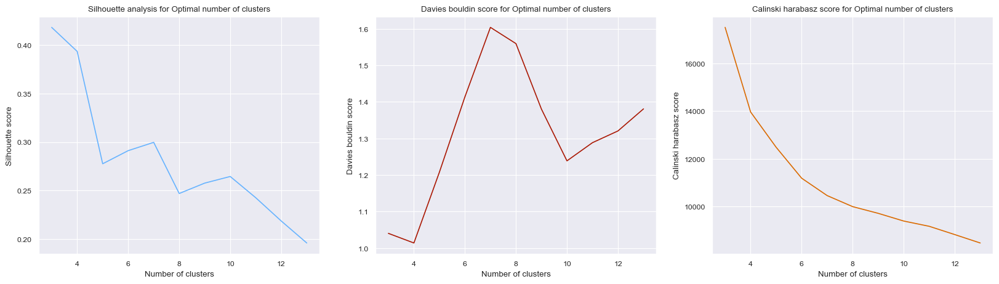

In [78]:
from sklearn.cluster import AgglomerativeClustering

sil_score_cah = []
cal_score_cah =[]
davies_score_cah = []
n_components = range(3,14)
for k in n_components:
    cah = AgglomerativeClustering(n_clusters = k)
    cahModel=cah.fit(data_cluster_scaled)
    sil_score_cah.append(silhouette_score(data_cluster_scaled, cah.labels_))
    davies_score_cah.append(davies_bouldin_score(data_cluster_scaled, cah.labels_))
    cal_score_cah.append(calinski_harabasz_score(data_cluster_scaled, cah.labels_))
    
plt.subplots(figsize=(20, 5))


plt.subplot(1,3,1)
plt.plot(n_components,sil_score_cah, color = "#66b3ff")
plt.xlabel('Number of clusters') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis for Optimal number of clusters')


plt.subplot(1,3,2)
plt.plot(n_components,davies_score_cah, color="#AA1803")
plt.xlabel('Number of clusters') 
plt.ylabel('Davies bouldin score') 
plt.title('Davies bouldin score for Optimal number of clusters')

plt.subplot(1,3,3)
plt.plot(n_components,cal_score_cah, color="#DA6A00")
plt.xlabel('Number of clusters') 
plt.ylabel('Calinski harabasz score') 
plt.title('Calinski harabasz score for Optimal number of clusters')

In [79]:
cah=AgglomerativeClustering(n_clusters = nb_clusters_agg
                             )

clustered_cah= data_cluster_sample
clustered_cah['labels_cah']= cah.fit(data_cluster_scaled).labels_

# groupig the recency, frequency and monetary value on the basis of clusters
clustered_cah.groupby(['labels_cah']).agg({
            'recency': 'mean',
            'frequency': 'mean',
            'total_payment_log': ['mean', 'count'],
            'freight_value': 'mean',
            'review_score_mean': ['mean', 'count']
        })

recency frequency total_payment_log        freight_value  \
                  mean      mean              mean  count          mean   
labels_cah                                                                
0           173.172840  1.045136          4.574940  10125     17.095997   
1           357.805775  1.049853          4.657369   4433     17.748089   
2           236.976659  1.115861          4.753571   3556     19.058186   
3           111.524442  1.058841          4.704509   3314     20.252831   
4           433.028024  1.043671          4.560793   4282     16.455908   
5           270.758684  1.032907          5.862573    547     52.178113   
6           175.140283  1.102960          5.527914   1554     42.531278   
7           243.783732  1.081340          4.669361   1045     20.025113   
8           298.107595  4.468354          6.153425    632     17.148667   
9           286.765625  4.462891          6.182930    512     19.531611   

           review_score_mean         
                        mean  count  
labels_cah                           
0                   4.555556  10125  
1                   4.689826   4433  
2                   1.539933   3556  
3                   4.717713   3314  
4                   4.571228   4282  
5                   3.550274    547  
6                   4.748820   1554  
7                   1.266986   1045  
8                   4.357709    632  
9                   3.663184    512

In [80]:
data_score_clustering.loc[4] = ["Aggclustering", nb_clusters_agg, silhouette_score(data_cluster_scaled, clustered_cah['labels_cah']), calinski_harabasz_score(data_cluster_scaled, clustered_cah['labels_cah']), davies_bouldin_score(data_cluster_scaled,clustered_cah['labels_cah'])]


print("Silhouette score for 12 cluster from model AgglomerativeClustering", data_score_clustering.loc[4]['silhouette_score'])
print("Calinski harabasz score for 12 cluster from model AgglomerativeClustering", data_score_clustering.loc[4]['calinski_harabasz_score'])
print("Davies bouldin score for 12 cluster from model AgglomerativeClustering", data_score_clustering.loc[4]['davies_bouldin_score'])

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.



Silhouette score for 12 cluster from model AgglomerativeClustering 0.26449944522320534
Calinski harabasz score for 12 cluster from model AgglomerativeClustering 9395.883897881287
Davies bouldin score for 12 cluster from model AgglomerativeClustering 1.2386758429002251


c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.



In [81]:
fig2 = px.scatter_3d(clustered_cah, x='recency', y='frequency', z='total_payment_log', color='labels_cah',width=1000, height=700)
fig2.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig2.show()

In [102]:
data_score_clustering.round(2)

,Model,Number_of_cluster,silhouette_score,calinski_harabasz_score,davies_bouldin_score
0,Kmeans,10,0.34,63142.69,1.06
1,Gaussian mixture,10,0.17,28159.26,1.87
2,Birch,10,0.67,449156.77,0.57
3,Dbscan,10,-0.71,31.13,4.66
4,Aggclustering,10,0.26,9395.88,1.24


C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1498: F

Text(0.5, 0.98, 'Scoring for different models')

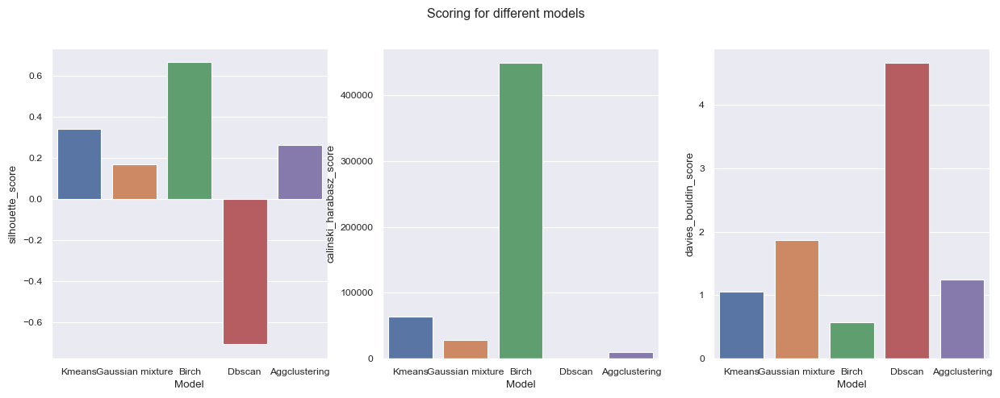

In [103]:
fig, ax = plt.subplots(1,3,figsize=(15,5))
sns.barplot(x = 'Model', y='silhouette_score', data = data_score_clustering, ax=ax[0])
sns.barplot(x = 'Model', y='calinski_harabasz_score', data = data_score_clustering, ax=ax[1])
sns.barplot(x = 'Model', y='davies_bouldin_score', data = data_score_clustering, ax=ax[2])
fig.suptitle("Scoring for different models")

### Interpretation fonctionnel du cluster

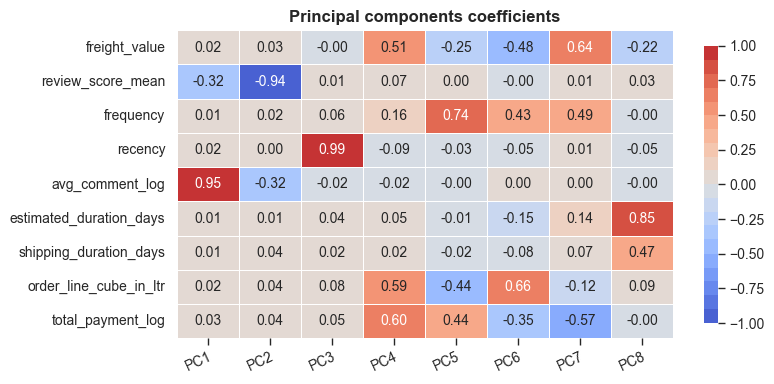

In [112]:

plot_heatmap(pca_df,'Principal components coefficients', vmin=-1, vmax=1, center=0,
             palette=sns.color_palette("coolwarm", 20),figsize=(8,4),shape='rect')
plt.show()

In [ ]:
data_cluster=df[numerical_columns].copy().dropna()
data_reduce = data_cluster.sample(10000, random_state=1).copy()

BIRCH

In [91]:
from sklearn.cluster import Birch
from sklearn.metrics import calinski_harabasz_score
nb_clusters_agg=10
cluster_brc = Birch(branching_factor = 2000, n_clusters = nb_clusters_agg, threshold = 0.4)


scaler = MinMaxScaler()
X_scaled_bis = scaler.fit_transform(X_proj)
data_cluster_scaled = scaler.fit_transform(data_cluster)
X_scaled_bis_1 = pd.DataFrame(data_cluster_scaled, index=data_cluster.index, columns=data_cluster.columns)
cluster_labels = cluster_brc.fit_predict(X_scaled_bis)  # Get cluster labels using fit_predict instead of fit
X_scaled_bis_2=X_scaled_bis_1.copy()
# Add cluster labels to the data_cluster_scaled DataFrame
X_scaled_bis_1['index_cluster'] = cluster_labels
X_scaled_bis_2['Segments_RFM'] = df['Segments_RFM']
# Rest of your code
brc_clusters_means = X_scaled_bis_1.groupby('index_cluster').mean()
rfm_df=X_scaled_bis_2.groupby('Segments_RFM').mean()
brc_clusters_means


c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `

,freight_value,review_score_mean,frequency,recency,avg_comment_log,estimated_duration_days,shipping_duration_days,order_line_cube_in_ltr,total_payment_log
index_cluster,,,,,,,,,
0,0.225774,0.865365,0.670100,0.285016,0.944027,0.141131,0.055927,0.117615,0.764247
1,0.233118,0.897434,0.009069,0.259721,0.942965,0.137706,0.054627,0.107746,0.481858
2,0.255289,0.200916,0.686183,0.529520,0.962996,0.156618,0.078657,0.137071,0.793411
3,0.225297,0.928382,0.009213,0.254045,0.000000,0.134004,0.052370,0.103004,0.474567
4,0.215795,0.849665,0.723520,0.514601,0.000000,0.142502,0.056125,0.118576,0.793055
5,0.241693,0.281255,0.020823,0.410856,0.000000,0.145334,0.087630,0.126599,0.487263
6,0.251480,0.075051,0.021559,0.419601,0.966338,0.146462,0.090872,0.151842,0.520361
7,0.225284,0.913110,0.010877,0.730020,0.000000,0.143680,0.054295,0.136439,0.486521
8,0.235038,0.901704,0.011711,0.735948,0.941919,0.146567,0.056007,0.143032,0.498696


In [92]:
print("Silhouette score for  cluster from model Birch",silhouette_score(X_scaled_bis_1, cluster_labels))
print("Calinski harabasz score for  cluster from model Birch", calinski_harabasz_score(X_scaled_bis_1, cluster_labels))
print("Davies bouldin score for  cluster from model Birch", davies_bouldin_score(X_scaled_bis_1, cluster_labels))

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.



Silhouette score for  cluster from model Birch 0.6658683186559461
Calinski harabasz score for  cluster from model Birch 449156.76563078596
Davies bouldin score for  cluster from model Birch 0.5680001320491552


c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `

In [113]:
datacomp=df.dropna()
datarfmcomp=df_RFM.dropna()

datacomp['index_cluster']=X_scaled_bis_1['index_cluster']

In [114]:
datacomp['Segment'] = datarfmcomp['R'].astype(str) + datarfmcomp['F'].astype(str) + datarfmcomp['M'].astype(str)

In [115]:
datacomp['index_cluster'].value_counts()

index_cluster
3    30001
1    16738
7    15593
6     9815
8     9376
5     6243
4     1841
0      602
9      524
2      427
Name: count, dtype: int64

In [116]:
# Créez la matrice de contingence entre les deux variables
contingency_matrix = pd.crosstab(datacomp['Segment'], datacomp['index_cluster'])

# Affichez la matrice de contingence
print("Matrice de Contingence :")
print(contingency_matrix)

Matrice de Contingence :
index_cluster    0     1    2     3    4    5    6     7     8    9
Segment                                                            
111              0     0    0     0    0  175  284  2117  1122    0
112              0     0    0     0    0  173  309  1914  1172    0
113              0     0    0     0    0  111  292  1723  1099    0
114              0     0    0     0    0  131  279  1623  1015    0
115              0     0    0     0    0  102  302  1308   948    0
151              0     0    1     0    0    3    3    15     9    0
152              0     0    0     0    4    7   16    63    37    3
153              0     0    5     0    7   17   21    89    66   12
154              0     0   16     0   41   17   29   139    86   45
155              0     0  100     0  482   25   46   184   131  304
211              0   353    0   688    0  314  322  1118   593    0
212              0   345    0   573    0  295  378  1380   758    0
213              0   26

In [117]:
plot_radars(brc_clusters_means, 'index_cluster')

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `

In [118]:
plot_radars(rfm_df, 'Segments_RFM')

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

c:\ProgramData\anaconda3\lib\site-packages\sklearn\utils\validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `

In [119]:
d=df[numerical_columns].copy().dropna()
d['index_cluster']=X_scaled_bis_1['index_cluster']
cluster_gby = d.groupby('index_cluster').mean()
cluster_gby

,freight_value,review_score_mean,frequency,recency,avg_comment_log,estimated_duration_days,shipping_duration_days,order_line_cube_in_ltr,total_payment_log
index_cluster,,,,,,,,,
0,19.348214,4.461462,4.350498,167.744186,3.708188,24.593023,11.632890,15.692761,6.064363
1,19.977621,4.589736,1.045346,153.300514,3.678116,24.068945,11.362349,14.389993,4.676967
2,21.877604,1.803663,4.430913,307.355972,4.245381,26.962529,16.360656,18.260799,6.207647
3,19.307390,4.713526,1.046065,150.059665,-23.025851,23.502583,10.892937,13.764125,4.641146
4,18.493056,4.398661,4.617599,298.837045,-23.025851,24.802825,11.674090,15.819494,6.205901
5,20.712436,2.125020,1.104117,239.598911,-23.025851,25.236104,18.226974,16.878563,4.703520
6,21.551209,1.300204,1.107794,244.592155,4.340013,25.408762,18.901375,20.210544,4.866135
7,19.306267,4.652440,1.054383,421.841211,-23.025851,24.983069,11.293337,18.177376,4.699876
8,20.142150,4.606815,1.058554,425.226109,3.648492,25.424808,11.649531,19.047700,4.759693


In [120]:

rfm_df_gby = rfm_df.groupby('Segments_RFM').mean()
rfm_df_gby

,freight_value,review_score_mean,frequency,recency,avg_comment_log,estimated_duration_days,shipping_duration_days,order_line_cube_in_ltr,total_payment_log
Segments_RFM,,,,,,,,,
About To Sleep,0.196802,0.771587,0.000930,0.478116,0.391067,0.143188,0.066919,0.101777,0.440492
At Risk,0.210922,0.726050,0.401784,0.607123,0.445333,0.136712,0.056724,0.113310,0.650180
Cannot Lose Them,0.278678,0.780169,0.051862,0.734023,0.414352,0.151060,0.063693,0.193948,0.630605
Champions,0.257206,0.696845,0.410952,0.172896,0.463433,0.140186,0.052908,0.130659,0.725239
Hibernating customers,0.170742,0.793909,0.000000,0.561856,0.365581,0.127260,0.057921,0.068073,0.339066
Lost customers,0.173165,0.794470,0.000877,0.827407,0.375598,0.147447,0.055928,0.063408,0.335114
Loyal,0.220628,0.674252,0.475116,0.394278,0.444769,0.159469,0.072784,0.130887,0.732264
New Customers,0.167831,0.795424,0.000000,0.215516,0.355102,0.120946,0.051095,0.049378,0.320794
Potential Loyalist,0.154887,0.679385,0.225285,0.248481,0.422047,0.130123,0.050596,0.041475,0.446814


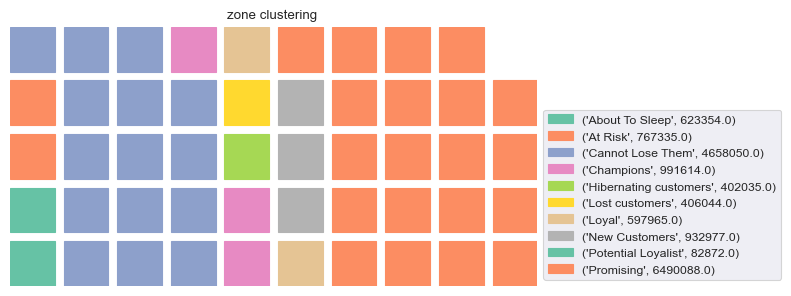

In [128]:
cv.plot_waffle_chart(datacomp, 'total_payment', 'sum', 'zone clustering ','Segments_RFM')

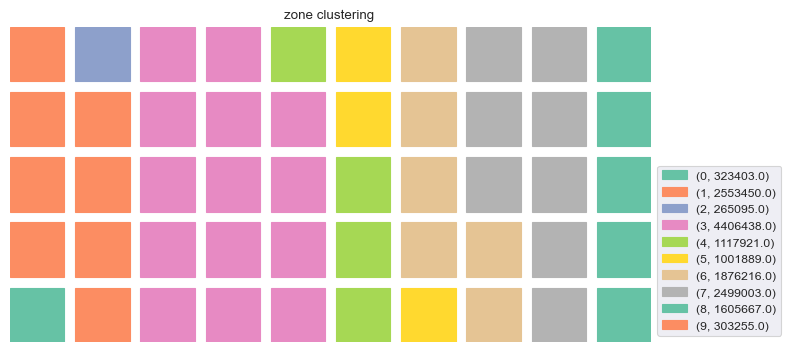

In [129]:
cv.plot_waffle_chart(datacomp, 'total_payment', 'sum', 'zone clustering ','index_cluster')

In [131]:
import folium
import pandas as pd
import matplotlib.pyplot as plt

# Charger votre DataFrame contenant les informations (latitude, longitude, segment)
# df = pd.read_csv('votre_fichier.csv')

# Créer une carte centrée sur le Brésil
brazil_map = folium.Map(location=[-14.235, -51.9253], zoom_start=4)

segment_colors = {
    0: 'red',#inactive
    1: 'orange',#active
    2: 'yellow',#hot
    3: 'green',#cold
    4: 'blue',
    5: 'purple',
    6: 'pink',
    7: 'brown',
    8: 'gray',
    9: 'black'
}

# Créer un nuage de points en fonction des coordonnées (latitude, longitude) et colorer en fonction des segments
for index, row in datacomp.iterrows():
    lat, lon, segment = row['geolocation_lat'], row['geolocation_lng'], row['index_cluster']
    
    # Vérifier si le segment est présent dans la palette de couleurs
    color = segment_colors.get(segment, 'gray')  # Gris par défaut pour les segments non définis
    
    # Ajouter le point à la carte
    folium.CircleMarker(
        location=[lat, lon],
        radius=1,  # Ajustez la taille des points selon vos préférences
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
    ).add_to(brazil_map)

# Afficher la carte
brazil_map.save('nuage_de_points10.2.html')  # Enregistrez la carte en HTML
